# Project Notebook


### Notebook

This notebook is a step by step guide on how to reproduce the analyses described in the MIS-C article. The analyses described are performed in an automated manner following a sequence of steps defined with the Clinical Knowledge Graph together with a data processing tailored for BBH. Here, we use CKG's API to show this analytical workflow. 

In [420]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
from scipy.stats import zscore
from matplotlib.pyplot import gcf
from itertools import compress

from matplotlib_venn import venn2
import matplotlib.pyplot as plt
from matplotlib_venn import venn3


import ckg.ckg_utils as ckg_utils

from ckg.analytics_core.analytics import analytics
from ckg.analytics_core.viz import viz

from ckg.report_manager import project, knowledge
from ckg.report_manager.dataset import  ProteomicsDataset, ClinicalDataset

from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
import plotly.express as px

%matplotlib inline
init_notebook_mode()

In [421]:
proteomics_filepath = '/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/data/proteomics_processed_low_miss_batch_adjusted.tsv'
experimental_filepath = '/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/data/experimental.tsv'
info_filepath = '/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/data/sample_info.xlsx'

## Load Data

The project data has already been loaded into CKG. The pipeline starts by building this project based on the types of datasets available (Clinical, Proteomic, etc.). 
We can access the data by creating a `project` object with the right project ifentifier and CKG will retrieve all the available data for us using the `query_data()` function.

In [422]:
info = pd.read_excel(info_filepath)
info["analytical_sample external_id"] = "1" + "_" + info["analytical_sample external_id"].astype(str)
info.tail()

,analytical_sample external_id,batch,replicate
147,1_ablank,3.0,18
148,1_ablank,3.0,19
149,1_ablank,3.0,20
150,1_ablank,3.0,21
151,1_ablank,3.0,22


In [423]:
experimental = pd.read_csv(experimental_filepath, sep ='\t')
experimental.head()

,sample,subject,grouping1,grouping2
0,1_a176813,1,Kawasaki,NaN
1,1_a189051,2,MIS-C,DIAGNOSTIC
2,1_a189050,2,MIS-C,REDUCED DISEASE
3,1_a189829,2,MIS-C,NO DISEASE
4,1_a174416,3,Virus,NaN


In [424]:
proteome = pd.read_csv(proteomics_filepath, sep='\t').drop('batch', axis = 1)
#proteome = pd.read_csv(proteomics_filepath,sep='\t')
proteome.head()

,group,sample,subject,A1BG~P04217,A2M~P01023,ACTA2~P62736,ACTBL2~Q562R1,ACTB~P60709,ADIPOQ~Q15848,AFM~P43652,...,SERPING1~P05155,SHBG~P04278,TF~P02787,TGFBI~Q15582,THBS1~P07996,TLN1~Q9Y490,TTR~P02766,VTN~P04004,VWF~P04275,WFDC3~Q8IUB2
0,pool,1_apool,1_apool,19.979747,19.607285,13.607576,13.241896,13.869643,13.496992,18.347121,...,19.120083,16.526508,22.605593,13.629561,14.793235,12.115754,17.464769,19.759426,14.475512,19.633768
1,pool,2_apool,2_apool,20.020110,19.721223,13.053219,14.134200,13.849514,13.318550,18.391718,...,19.020920,16.260055,22.604795,13.871114,14.775353,11.760121,17.113264,19.760263,14.502093,19.471067
2,pool,3_apool,3_apool,19.932705,19.624992,13.521027,13.794858,14.024850,13.286143,18.354002,...,18.666119,16.243407,22.450173,13.832883,14.758682,12.203773,17.215359,19.844709,14.511329,19.513528
3,pool,4_apool,4_apool,19.990314,19.651460,13.429590,14.196144,14.143781,13.467136,18.223973,...,18.958776,16.141056,22.547586,14.029574,14.745127,10.182243,17.016556,19.592241,14.493043,19.498976
4,sample,1_a103716478120,1_a103716478120,19.687100,19.302808,13.958475,13.664084,14.178586,12.789042,17.447258,...,19.685568,16.169808,22.021958,13.741313,11.071191,11.835480,17.954579,19.903407,15.990181,19.070985


Here, `project_info` contains all the information (attributes) for the chosen project: name, acronym, description, etc, as well as overlap and similarity with other projects in CKG's database. We save these attributes and project similarities in the `project` object `p`.

In [425]:
root_dir = '/Users/tzx804/projects/collaborations/nicolai/misc/sepsis'

In [426]:
# add clinical info to proteome
processed_data = pd.merge(proteome.drop(['group','subject'], axis = 1), experimental, on = 'sample')
print(processed_data.shape)
# average mis_c diagnostic and still 100% disease
subjects = processed_data.loc[processed_data.grouping2=='STILL 100% DISEASE'].subject.tolist()
for subject in subjects:
    sub = processed_data.loc[(processed_data.subject == subject)&(processed_data.grouping2!='REDUCED DISEASE')]
    new_avg = sub.iloc[:,1:-3].mean().tolist()
    processed_data.iloc[sub.loc[sub.grouping2=='DIAGNOSTIC'].index,1:-3]=new_avg
# remove still 100% disease
processed_data = processed_data.loc[processed_data.grouping2!='STILL 100% DISEASE'].reset_index(drop=True)
print(processed_data.shape)

(109, 249)
(107, 249)


In [427]:
processed_data['group']=processed_data.grouping2.copy()
processed_data.loc[processed_data.grouping2.isnull(),'group']=processed_data.loc[processed_data.grouping2.isnull()].grouping1.tolist()
processed_data.loc[processed_data.grouping1=='MIS-C','group']=['MIS-C_'+i for i in processed_data.loc[processed_data.grouping1=='MIS-C']['group'].tolist()]

processed_data.replace('Bak','Bacteria', inplace = True)
processed_data.replace('MIS-C_DIAGNOSTIC','MIS-C Acute Stage', inplace = True)
processed_data.replace('MIS-C_REDUCED DISEASE','MIS-C During Admission', inplace = True)
processed_data.replace('MIS-C_NO DISEASE','MIS-C Full Recovery', inplace = True)

processed_data['group'].value_counts()

Bacteria                  28
MIS-C Acute Stage         27
Virus                     22
MIS-C Full Recovery        9
Sepsis                     7
Kawasaki                   7
MIS-C During Admission     7
Name: group, dtype: int64

# Analysis Plan

**Unsupervised analysis**
1) UMAP
2) Heatmap (correlation)

**Differential analysis** 
1) All groups compared to MIS-C

**ML analysis**
1) Run feature reduction and train ML based diagnostic classifier between mis-c and febrile controls

2) Test model prediction probabilities, MCC, AUROC for validation cohorts (sepsis, kawasaki, no-disease, reduced disease, and test set)

3) Repeat analysis workflow for PRIDE validation


In [428]:
all_processed_proteins = processed_data.drop(['subject','sample','group','grouping1','grouping2'], axis = 1).columns.tolist()
print(len(all_processed_proteins))

245


In [429]:
not_igs = processed_data.columns[~processed_data.columns.str.contains('^IGH|^IGK|^IGL|^IGM|^IGG|^IGA')]
print(len(not_igs))

184


In [430]:
processed_data.shape

(107, 250)

In [431]:
processed_copy = processed_data.drop(['grouping1','grouping2'], axis = 1)

In [432]:
processed_data = processed_data[not_igs]
processed_data.drop(['grouping1','grouping2'], axis = 1, inplace = True)

# Unsupervised clustering

In [433]:
from umap import UMAP
processed_sub = processed_data.drop(['sample','subject'], axis = 1)
processed_sub = processed_sub.loc[~processed_sub.group.isin(['MIS-C During Admission','MIS-C Full Recovery'])]
color_discrete_sequence=["rgb(204,97,176)", "rgb(175,100,88)","rgb(217,175,107)","rgb(118,78,159)","rgb(57,105,172)"]#, "rgb(47,138,196)","rgb(179,179,179)"]

features = processed_sub.drop(['group'], axis = 1)

umap_2d = UMAP(n_components=2, init='random', random_state=0)

proj_2d = umap_2d.fit_transform(features)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=processed_sub.group, labels={'color': 'group'}, 
    color_discrete_sequence=color_discrete_sequence,#px.colors.qualitative.Vivid,
    template = 'plotly_white', height = 500, width = 700
)

fig_2d.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/umap.pdf')
fig_2d.show()

# Heatmap

### Heatmap with data before imputation

In [434]:
proteins = pd.DataFrame(processed_data.drop(['sample','group','subject'], axis = 1).columns)[0].str.split('~', expand = True)[0].tolist()

(109, 455)
(107, 455)


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



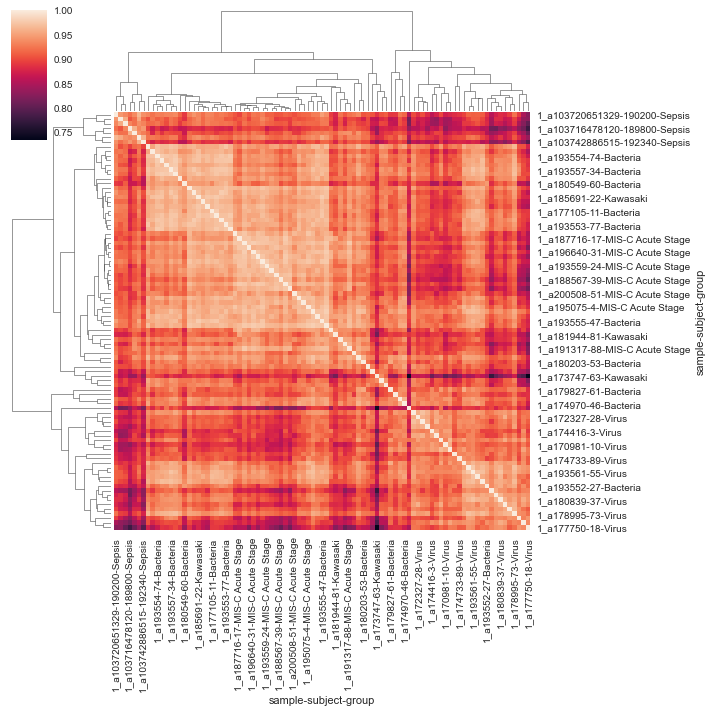

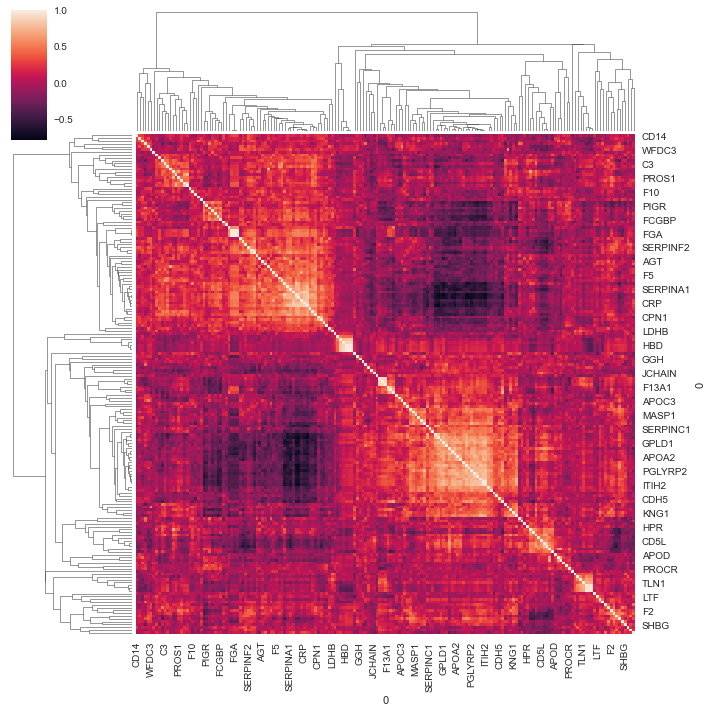

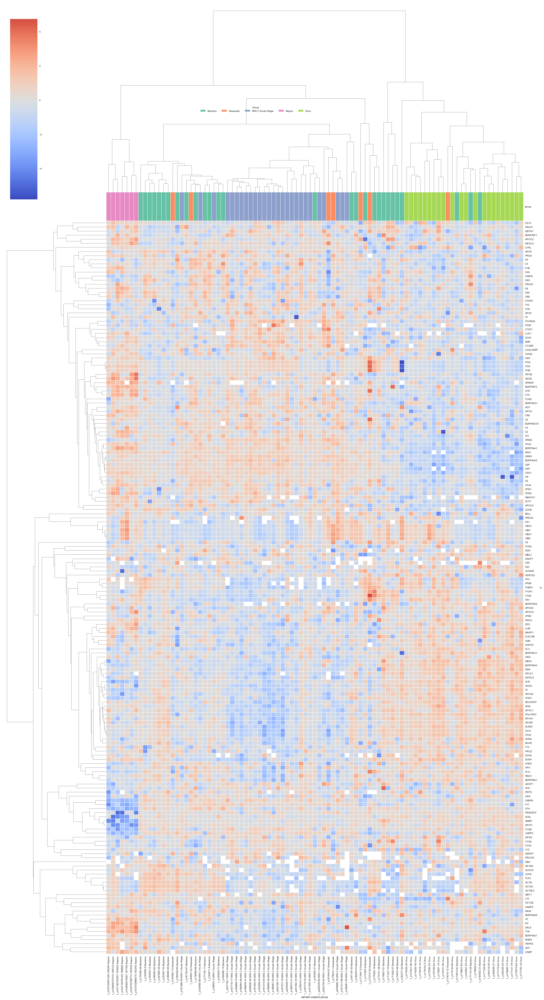

In [435]:
proteomics_raw = pd.read_csv('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/data/proteomics_raw.tsv', sep ='\t')
proteomics_raw.LFQ_intensity = np.log(proteomics_raw.LFQ_intensity)
proteomics_raw.rename(columns = {'samples':'sample'}, inplace = True)
proteomics_raw = pd.pivot_table(proteomics_raw, values = 'LFQ_intensity', index = 'sample', columns = 'name')

# add clinical info to proteome
proteomics_raw = pd.merge(experimental, proteomics_raw, right_index=True, left_on = 'sample', how = 'inner')
print(proteomics_raw.shape)
# average mis_c diagnostic and still 100% disease
subjects = proteomics_raw.loc[proteomics_raw.grouping2=='STILL 100% DISEASE'].subject.tolist()
for subject in subjects:
    sub = proteomics_raw.loc[(proteomics_raw.subject == subject)&(proteomics_raw.grouping2!='REDUCED DISEASE')]
    new_avg = sub.iloc[:,4:].mean().tolist()
    proteomics_raw.iloc[sub.loc[sub.grouping2=='DIAGNOSTIC'].index,4:]=new_avg
# remove still 100% disease
proteomics_raw = proteomics_raw.loc[proteomics_raw.grouping2!='STILL 100% DISEASE'].reset_index(drop=True)
print(proteomics_raw.shape)

# rename
proteomics_raw['group']=proteomics_raw.grouping2.copy()
proteomics_raw.loc[proteomics_raw.grouping2.isnull(),'group']=proteomics_raw.loc[proteomics_raw.grouping2.isnull()].grouping1.tolist()
proteomics_raw.loc[proteomics_raw.grouping1=='MIS-C','group']=['MIS-C_'+i for i in proteomics_raw.loc[proteomics_raw.grouping1=='MIS-C']['group'].tolist()]

proteomics_raw.replace('Bak','Bacteria', inplace = True)
proteomics_raw.replace('MIS-C_DIAGNOSTIC','MIS-C Acute Stage', inplace = True)
proteomics_raw.replace('MIS-C_REDUCED DISEASE','MIS-C During Admission', inplace = True)
proteomics_raw.replace('MIS-C_NO DISEASE','MIS-C Full Recovery', inplace = True)

proteomics_raw.drop(['grouping1','grouping2'], axis = 1, inplace = True)

# prepare heatmap data
# proteomics_raw.T.loc[not_igs].T
proteomics_raw.subject = proteomics_raw.subject.astype(str)
data = proteomics_raw.loc[~proteomics_raw.group.isin(['MIS-C During Admission','MIS-C Full Recovery'])]

# Heatmap of protein expression with labels
heatmap_data = data.sort_values(['group']).set_index(['sample','subject','group'])
heatmap_data.columns = pd.DataFrame(heatmap_data.columns.tolist())[0].str.split('~', expand = True)[0]
heatmap_data = heatmap_data.T

heatmap_data = heatmap_data.loc[proteins]

# grouping colors
group_labels = heatmap_data.columns.get_level_values("group")
group_pal = sns.color_palette('Set2',group_labels.unique().size)
group_lut = dict(zip(map(str, group_labels.unique()), group_pal))
# create group index
group_colors = pd.Series(group_labels, index=heatmap_data.columns).map(group_lut)

# cluster patients according to their correlation
col_linkage = sns.clustermap(heatmap_data.corr(), metric = 'correlation').dendrogram_col.linkage
row_linkage = sns.clustermap(heatmap_data.T.corr(), metric = 'correlation').dendrogram_col.linkage

g = sns.clustermap(heatmap_data, mask = heatmap_data.isnull(), z_score = 0,
                   figsize=(30, 55), col_colors = group_colors, 
                   col_linkage=col_linkage, row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white', cmap = 'coolwarm', center = 0)

# add legends
for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=5, bbox_to_anchor=(0.47, 0.89), bbox_transform=gcf().transFigure)
#g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/heatmap_unsupervised_RAW.pdf")

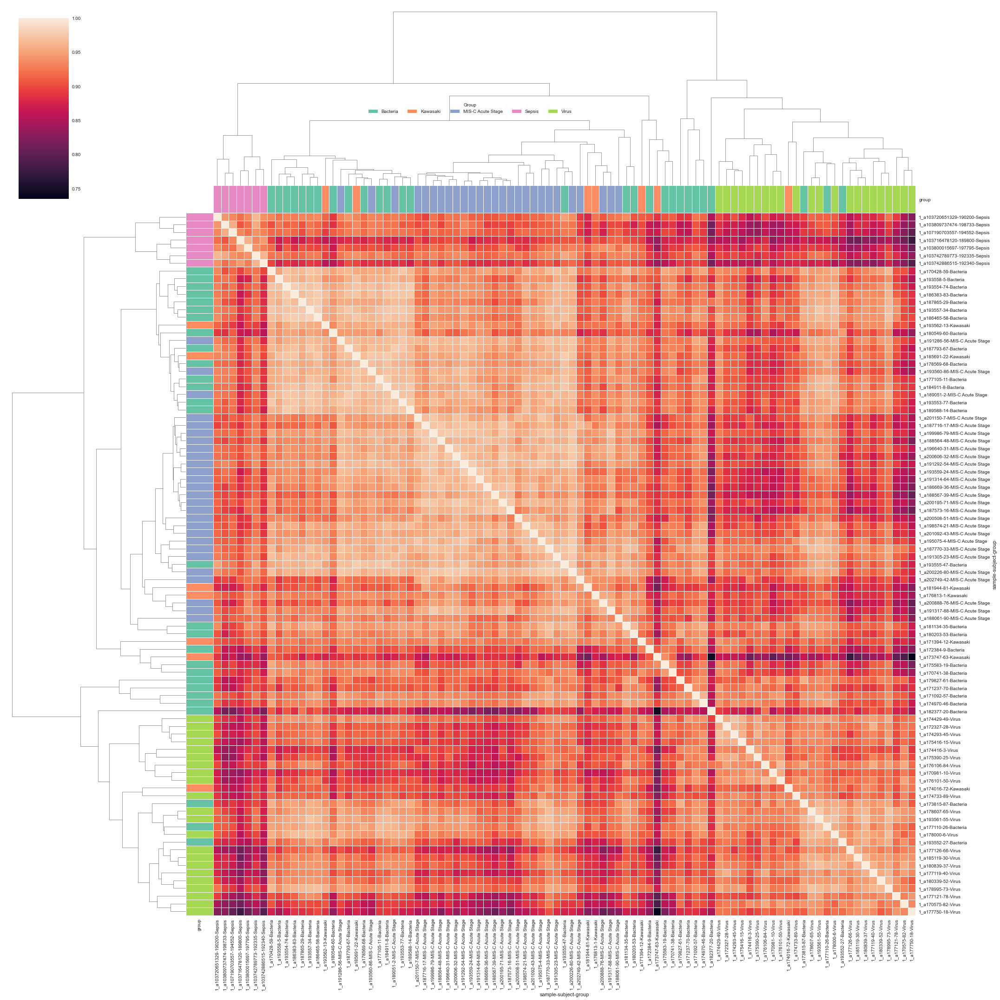

In [436]:
g = sns.clustermap(heatmap_data.corr(), metric = 'correlation',
                   figsize=(30, 30), col_colors = group_colors, row_colors = group_colors,
                   #col_linkage=col_linkage, row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white')

for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=5, bbox_to_anchor=(0.47, 0.89), bbox_transform=gcf().transFigure)
#g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/correlation_unsupervised_RAW.pdf")

### Heatmap of data after imputation: Sepsis clustering is lost

# Check for RNA proteins

In [437]:
uniprot_name = ['HSPB1','VP37C','TGFB1','MX2','TVBK2']
uniprot_identifier = ['Q96EW2','A5D8V6','P01137','P20592','A0A584']
rna_lst = ['HSPBAP1','VPS37C','TGFB1','MX2','TRBV11-2']

for lst in [uniprot_name, uniprot_identifier,rna_lst]:
    hits = proteomics_raw.columns.str.contains('|'.join(lst))
    if sum(hits)>0:
        print(proteomics_raw.columns[hits].tolist())
        print(sum(proteome.columns.str.contains('|'.join(lst))))
    else:
        print('no hits')

# missingness
proteomics_raw['HSPB1'].isnull().sum()/len(proteomics_raw['HSPB1'])

['HSPB1']
0
no hits
no hits


0.9439252336448598

**Only HSPB1 was identified in our data, but filtered out due to a high number of missing values**

# Differential Regulation

**Analysis of variance (ANOVA)** is a collection of statistical models and their associated estimation procedures (such as the "variation" among and between groups) used to analyze the differences among group means in a sample. ANOVA was developed by statistician and evolutionary biologist Ronald Fisher. The ANOVA is based on the law of total variance, where the observed variance in a particular variable is partitioned into components attributable to different sources of variation. In its simplest form, ANOVA provides a statistical test of whether two or more population means are equal, and therefore generalizes the t-test beyond two means.
**Interpretation:** In MS analysis, "vulcano plots" are used to visualize differentially regulated proteins. The vulcano plot shows significance as -log10(p-value) on the y-axis and abundance changes as log2(fold change) on the x-axis. This results in a plot where highly significant proteins with large changes in abundance are plottet in the upper right and left corners, depending on up- or down-regulation respectively. These proteins are highlighted as colored points in the plot. 

### All against all

In [438]:
anova_result = analytics.run_anova(processed_data.loc[processed_data.group.isin(['Bacteria','Virus','Kawasaki','Sepsis','MIS-C Acute Stage'])], drop_cols=['sample', 'subject'], 
                                   subject='subject', group='group', correction='fdr_bh')

In [439]:
anova_result.reset_index(drop=True)

for i in range(anova_result.shape[0]):
    if anova_result.loc[i,'group1']!= 'MIS-C Acute Stage':
        if anova_result.loc[i,'group2']== 'MIS-C Acute Stage':
            anova_result.loc[i,'log2FC']= -anova_result.loc[i,'log2FC']
            anova_result.loc[i,'group2']= anova_result.loc[i,'group1']
            anova_result.loc[i,'group1']= 'MIS-C Acute Stage'

args={'alpha':0.05, 
      'fc':2, 
      'colorscale':'Blues', 
      'showscale': False,
      'marker_size':10,
      'num_annotations':480,
      'x_title':'log2FC', 
      'y_title':'-log10(pvalue)'}
figures = viz.run_volcano(anova_result, identifier='volcano', args=args)
for figure in figures:
    iplot(figure.figure)

### Venn

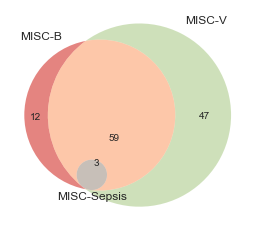

In [440]:
bacteria = pd.DataFrame(anova_result.loc[(anova_result.group2=='Bacteria')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['posthoc padj'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()
sepsis = pd.DataFrame(anova_result.loc[(anova_result.group2=='Sepsis')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['posthoc padj'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()
virus = pd.DataFrame(anova_result.loc[(anova_result.group2=='Virus')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['posthoc padj'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()


st = [item for item in bacteria if item in virus]
st_u = [item for item in st if item not in sepsis]

stc = [item for item in st if item in sepsis]

s_u = [item for item in bacteria if item not in virus]
s_u = [item for item in s_u if item not in sepsis]

tc = [item for item in virus if item in sepsis]
tc_u = [item for item in tc if item not in bacteria]
t_u = [item for item in virus if item not in bacteria]
t_u = [item for item in t_u if item not in sepsis]

c_u = [item for item in sepsis if item not in virus]
c_u = [item for item in c_u if item not in bacteria]

sc = [item for item in bacteria if item in sepsis]
sc_u = [item for item in sc if item not in virus]

stc_l = len(stc)

# Import the library
import matplotlib.pyplot as plt
from matplotlib_venn import venn3
#plt.figure(figsize=(10,10))

#fig, axes = plt.subplots(1, 1, figsize=(24, 8))
# Make the diagram
venn3(subsets = (len(s_u),len(t_u),len(st_u),len(c_u),len(sc_u),len(tc_u),len(stc)),
      set_labels = ('MISC-B', 'MISC-V','MISC-Sepsis'), alpha = 0.5)
plt.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/venn_VBS.pdf',bbox_inches='tight')
plt.show()

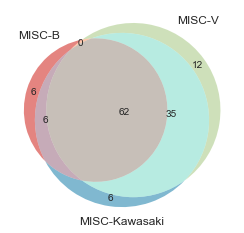

In [441]:
bacteria = pd.DataFrame(anova_result.loc[(anova_result.group2=='Bacteria')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['posthoc padj'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()
kawasaki = pd.DataFrame(anova_result.loc[(anova_result.group2=='Kawasaki')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['pvalue'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()
virus = pd.DataFrame(anova_result.loc[(anova_result.group2=='Virus')&(anova_result.group1=='MIS-C Acute Stage')&(anova_result['posthoc padj'] < 0.05)].identifier.tolist())[0].str.split('~', expand = True)[0].tolist()


st = [item for item in bacteria if item in virus]
st_u = [item for item in st if item not in kawasaki]

stc = [item for item in st if item in kawasaki]

s_u = [item for item in bacteria if item not in virus]
s_u = [item for item in s_u if item not in kawasaki]

tc = [item for item in virus if item in kawasaki]
tc_u = [item for item in tc if item not in bacteria]
t_u = [item for item in virus if item not in bacteria]
t_u = [item for item in t_u if item not in kawasaki]

c_u = [item for item in kawasaki if item not in virus]
c_u = [item for item in c_u if item not in bacteria]

sc = [item for item in bacteria if item in kawasaki]
sc_u = [item for item in sc if item not in virus]

stc_l = len(stc)

# Import the library
import matplotlib.pyplot as plt
from matplotlib_venn import venn3
#plt.figure(figsize=(10,10))

#fig, axes = plt.subplots(1, 1, figsize=(24, 8))
# Make the diagram
venn3(subsets = (len(s_u),len(t_u),len(st_u),len(c_u),len(sc_u),len(tc_u),len(stc)),
      set_labels = ('MISC-B', 'MISC-V','MISC-Kawasaki'), alpha = 0.5)
plt.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/venn_VBK.pdf',bbox_inches='tight')
plt.show()

In [442]:
import itertools

all_items = itertools.chain(sepsis, bacteria, virus, kawasaki)
all_items = list(set(all_items))

### Mis-c versus all

In [443]:
processed_all = processed_data.loc[processed_data.group.isin(['Bacteria','Virus','Kawasaki','Sepsis','MIS-C Acute Stage'])]
processed_all['combination']=processed_all.group.copy()
processed_all.loc[processed_all.combination!='MIS-C Acute Stage','combination']='Not MIS-C'

anova_result = analytics.run_anova(processed_all, drop_cols=['sample','group'], 
                                   subject='subject', group='combination', correction='fdr_bh')
#anova_result = analytics.run_ttest(processed_all, condition1='MIS-C Acute Stage', condition2='Not MIS-C', 
#                                   alpha = 0.05, drop_cols=['sample',"group"], 
#                                   subject='subject', group='combination', paired=False, correction='fdr_bh', 
#                                   permutations=0)

In [444]:
candidates = anova_result.loc[anova_result['rejected']==True].identifier.str.split('~', expand = True)[0].tolist()
print(len(candidates))

105


In [445]:
print('{} proteins from the combined venn list (total of {}) are in the significant list (total of {})'.format(len([item for item in all_items if item in candidates]),len(all_items), len(candidates)))

103 proteins from the combined venn list (total of 127) are in the significant list (total of 105)


In [446]:
print('{} proteins from the sepsis venn list (total of {}) are in the significant list (total of {})'.format(len([item for item in sepsis if item in candidates]),len(sepsis), len(candidates)))

3 proteins from the sepsis venn list (total of 3) are in the significant list (total of 105)


In [447]:
print('{} proteins from the kawasaki venn list (total of {}) are in the significant list (total of {})'.format(len([item for item in kawasaki if item in candidates]),len(kawasaki), len(candidates)))

95 proteins from the kawasaki venn list (total of 109) are in the significant list (total of 105)


In [448]:
print('{} proteins from the bacteria venn list (total of {}) are in the significant list (total of {})'.format(len([item for item in bacteria if item in candidates]),len(bacteria), len(candidates)))

68 proteins from the bacteria venn list (total of 74) are in the significant list (total of 105)


In [449]:
print('{} proteins from the virus venn list (total of {}) are in the significant list (total of {})'.format(len([item for item in virus if item in candidates]),len(virus), len(candidates)))

96 proteins from the virus venn list (total of 109) are in the significant list (total of 105)


# Volcano plot

In [450]:
# plotly volcano
anova_result['color']= 'darkgrey'
# switch "comparison direction"
anova2 = anova_result.copy()
anova2['log2FC']=(-1)*anova2.log2FC

In [451]:
anova2.loc[(anova2.rejected)].shape

(105, 18)

In [452]:
anova2.loc[(anova2.rejected)&(anova2.log2FC<0), 'color']='lightsteelblue'
anova2.loc[(anova2.rejected)&(anova2.log2FC>0), 'color']='indianred'

anova2['name']=anova2.identifier.str.split('~', expand = True)[0]
anova2.loc[~((anova2.rejected==True)&((anova2.log2FC>1)|(anova2.log2FC<-1))),'name']=np.nan
fig = px.scatter(anova2, x = 'log2FC', y = '-log10 pvalue', template = 'plotly_white',
              width = 700, height = 600, color = 'color', opacity = 0.7,
              color_discrete_map='identity',labels={"-log10 pvalue": "-log10(pvalue)","log2FC": "log2(FC)"}, 
              title = 'Volcanoplot: MIS-C vs. control groups', hover_data = anova2.columns, text = 'name')
fig.for_each_trace(lambda t: t.update(textfont_color=t.marker.color, textposition='top center', opacity = 1))
fig.update_xaxes(linewidth=2, linecolor='lightgrey', gridcolor='lightgrey', zeroline=True, zerolinecolor='lightgrey')
fig.update_yaxes(linewidth=2, linecolor='lightgrey',gridcolor='lightgrey',zeroline=True, zerolinecolor='lightgrey')
fig.add_vline(x=1, line_width=2, line_dash="dash", line_color="lightgrey")
fig.add_vline(x=-1, line_width=2, line_dash="dash", line_color="lightgrey")
fig.add_hline(y=anova2.loc[anova2.rejected]['-log10 pvalue'].min(), line_width=2, line_dash="dash", line_color="lightgrey")
fig.update_xaxes(range=[-2, 3.5])
fig.update_yaxes(range=[0, 14.5])
fig.update_traces(textposition='top center')


fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/volcano_misc_notmisc.pdf')
fig.show()

### correlation

In [453]:
candidates = anova_result.loc[anova_result.rejected==True].identifier.str.split('~', expand = True)[0].tolist()

data = processed_data.drop(['subject','sample','group'], axis = 1)
data.columns = pd.DataFrame(processed_data.drop(['subject','sample','group'], axis = 1).columns.tolist())[0].str.split('~', expand = True)[0]
data = data[candidates]
data[['group','sample']] = processed_data[['group','sample']]
data = data.loc[~data['group'].isin(['MIS-C Full Recovery','MIS-C During Admission'])]
data['combination']='Not-MISC'
data.loc[data.group=='MIS-CAcute Stage','combination']='MISC'

correlation_result = analytics.run_correlation(data[['sample','combination']+candidates], alpha=0.05,
                                               subject='sample', group='combination',
                                               method='spearman', correction='fdr_bh')

network = viz.get_network(correlation_result, identifier="Correlation network", 
                         args={'source':'node1', 'target':'node2', 
                               'title':'Correlation network', 'values':'weight',
                               'cutoff':0.5, 'cutoff_abs':True, 'color_weight': True,
                               'communities_algorithm': 'louvain'})

network_nodes = network['net_tables'][0]
network_network = network['net_tables'][1]
network_nodes.cluster.value_counts()
network_nodes['index'].shape
network_network.to_csv('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/network_notmisc.tsv', sep = '\t', index = False)
network_nodes.to_csv('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/nodes_notmisc.tsv', sep = '\t', index = False)

coexpression_network = viz.visualize_notebook_network(network['notebook'], notebook_type='jupyter', layout={})
coexpression_network

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/ckg/analytics_core/viz/viz.py:1680: FutureWarning:

Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.



Cytoscape(data={'elements': [{'data': {'degree': 16, 'radius': 16, 'color': '#1acf66', 'cluster': 0, 'id': 'AL…

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (2 levels on the left,1 on the right)



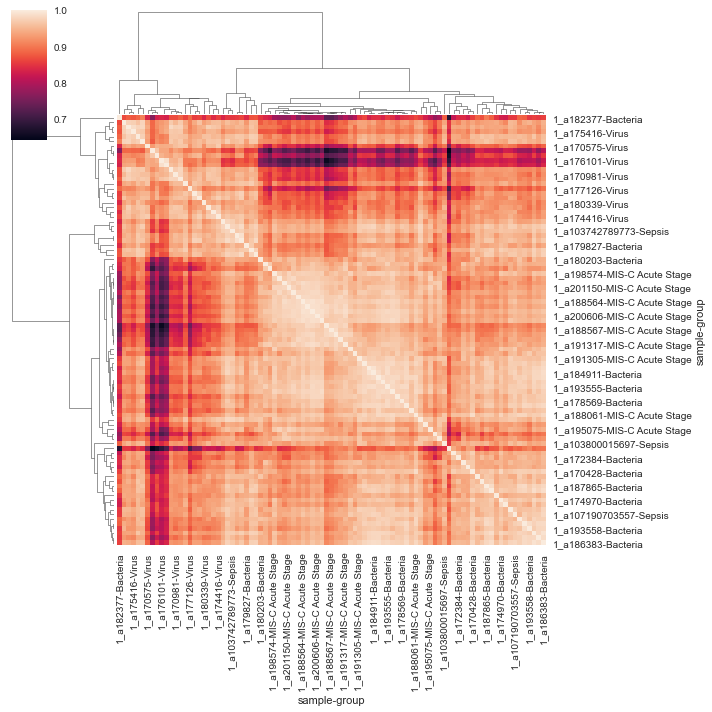

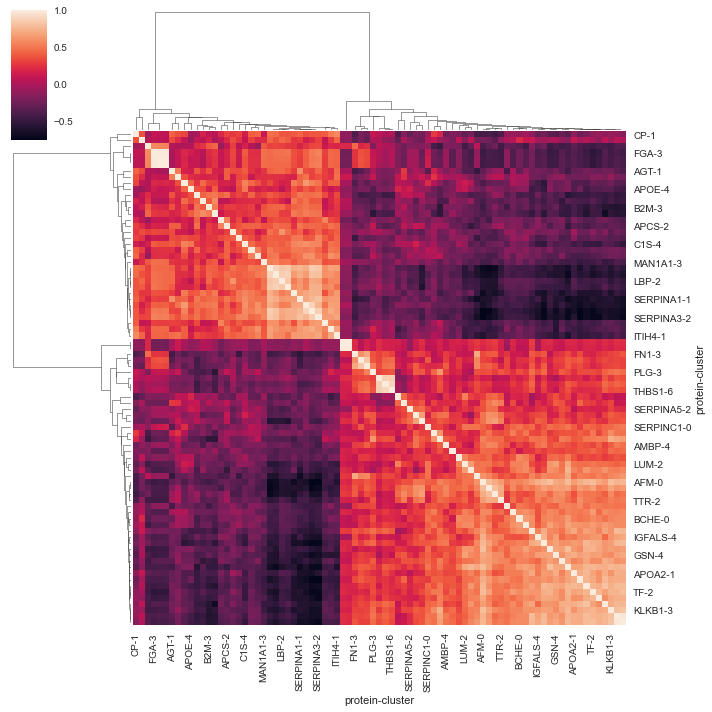

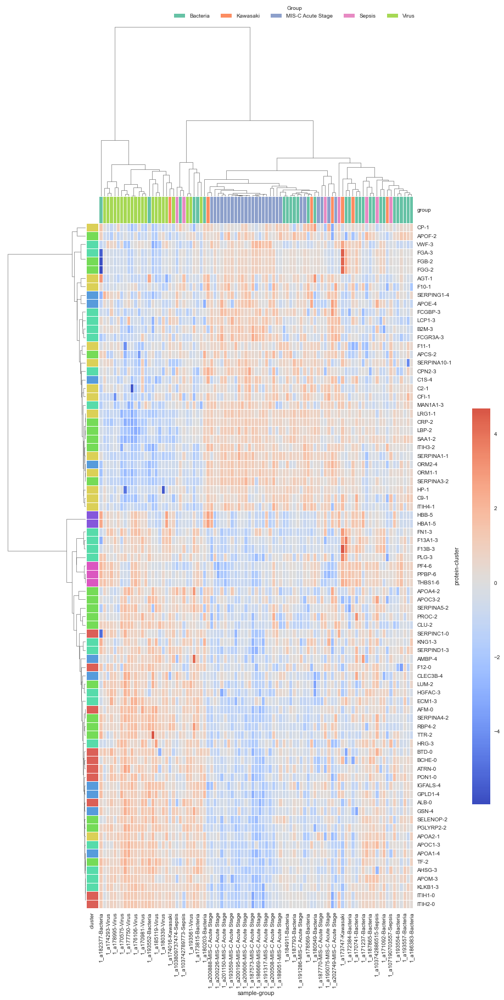

In [454]:
# Heatmap of protein expression with labels
heatmap_data = data.drop(['combination'], axis = 1).sort_values(['group']).set_index(['sample','group']).T
heatmap_data = pd.merge(heatmap_data, network_nodes[['index','cluster']], left_index=True, right_on = 'index', how = 'left')
heatmap_data.cluster = heatmap_data.cluster.astype(str)
heatmap_data.rename(columns={'index':'protein'}, inplace = True)
heatmap_data.protein = heatmap_data.protein.str.split('~', expand = True)[0]
heatmap_data.sort_values('cluster', inplace = True)
heatmap_data = heatmap_data.loc[heatmap_data.cluster!='nan']
heatmap_data.set_index(['protein','cluster'], inplace = True)
heatmap_data.columns = data.drop(['combination'], axis = 1).sort_values(['group']).set_index(['sample','group']).T.columns

# grouping colors
group_labels = heatmap_data.columns.get_level_values("group")
group_pal = sns.color_palette('Set2',group_labels.unique().size)
group_lut = dict(zip(map(str, group_labels.unique()), group_pal))
# create group index
group_colors = pd.Series(group_labels, index=heatmap_data.columns).map(group_lut)

# correlation colors
correlation_labels = heatmap_data.index.get_level_values("cluster")
corr_pal = sns.hls_palette(correlation_labels.unique().size)
corr_lut = dict(zip(map(str, correlation_labels.unique()), corr_pal))
# create correlation index
correlation_colors = pd.Series(correlation_labels, index=heatmap_data.index).map(corr_lut)

# cluster patients according to their correlation
col_linkage = sns.clustermap(heatmap_data.corr(), metric = 'correlation').dendrogram_col.linkage
row_linkage = sns.clustermap(heatmap_data.T.corr(), metric = 'correlation').dendrogram_col.linkage

g = sns.clustermap(heatmap_data, z_score = 0,
                   figsize=(15, 25), col_colors = group_colors, row_colors = correlation_colors,
                   col_linkage=col_linkage, row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white', cmap = 'coolwarm', center = 0)

# add legends
for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=7, bbox_to_anchor=(0.5, 1), bbox_transform=gcf().transFigure)
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.8, .2, .03, .4))
#g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/heatmap_notmisc_semisupervised.pdf")

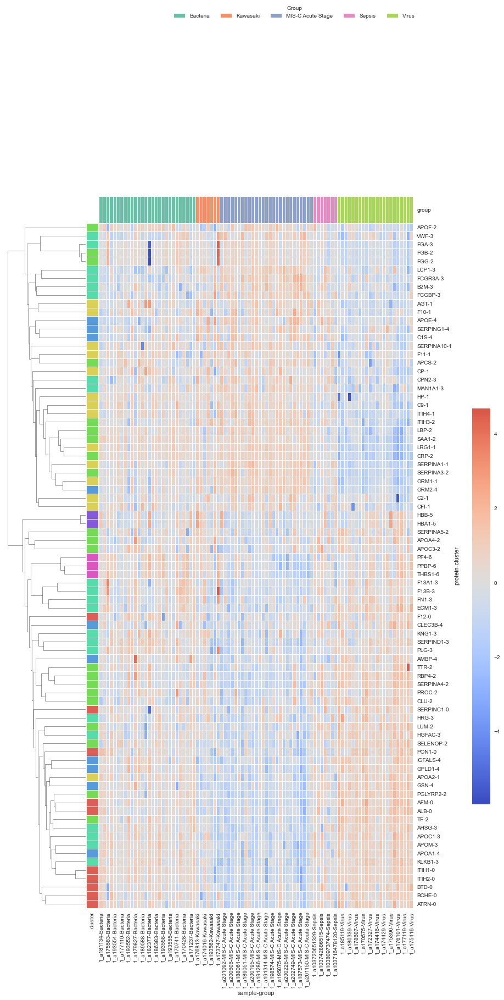

In [455]:
g = sns.clustermap(heatmap_data, z_score = 0,
                   figsize=(15, 25), col_colors = group_colors, row_colors = correlation_colors,
                   col_cluster=False,
                   #col_linkage=col_linkage, 
                   #row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white', cmap = 'coolwarm', center = 0)

# add legends
for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=7, bbox_to_anchor=(0.5, 1), bbox_transform=gcf().transFigure)
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.8, .2, .03, .4))
#g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/heatmap_notmisc_noclustering.pdf")

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/ipykernel_launcher.py:12: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (2 levels on the left,1 on the right)



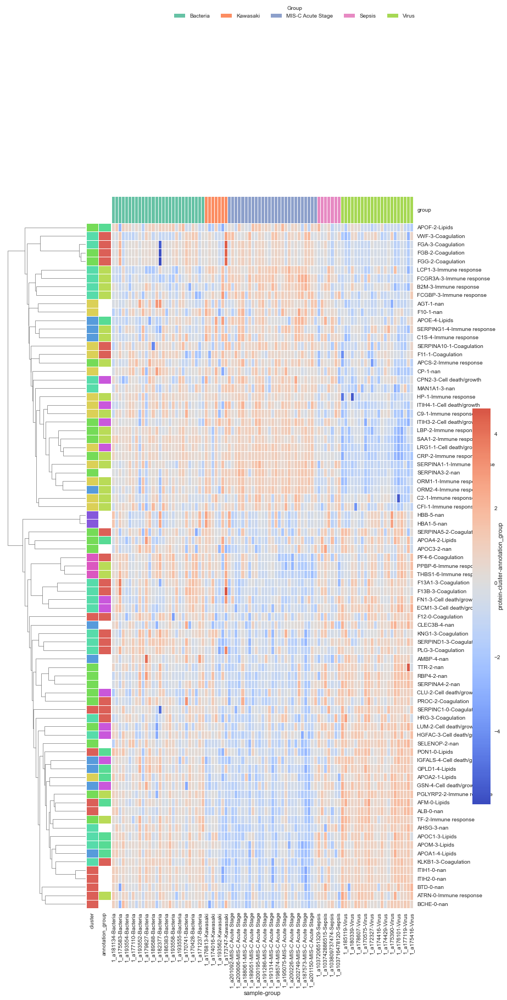

In [456]:
# add clinical annotation_df

annotation_df = pd.read_excel('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/data/MIS-C_sign_prot-12072023 111_UN_opdeling.xlsx')
#annotation_df.columns

### I will merge "cell death/growth and cell/death/growth/adhesion"
annotation_df['annotation_group']=annotation_df['Annelaura cathegorizaion'].copy()
annotation_df.loc[annotation_df.annotation_group == 'Cell death/growth/adhesion','annotation_group']='Cell death/growth'
annotation_df.loc[annotation_df.annotation_group == 'Other']=np.nan
annotation_df['protein'] = annotation_df.Identifier.str.split('~', expand = True)[0]

heatmap2 = pd.merge(heatmap_data, annotation_df[['protein','annotation_group']].drop_duplicates().set_index('protein'), left_index = True, right_index = True, how = 'left')
heatmap2 = heatmap2.reset_index().sort_values(['cluster','annotation_group']).set_index(['protein','cluster','annotation_group'])
heatmap2.columns = heatmap_data.columns

# correlation colors
correlation_labels = heatmap2.index.get_level_values("cluster")
corr_pal = sns.hls_palette(correlation_labels.unique().size)
corr_lut = dict(zip(map(str, correlation_labels.unique()), corr_pal))
# create correlation index
correlation_colors = pd.Series(correlation_labels, index=heatmap2.index).map(corr_lut)

# annotation colors
annotation_labels = heatmap2.index.get_level_values("annotation_group")
corr_pal = sns.hls_palette(annotation_labels.unique().size)
corr_lut = dict(zip(map(str, annotation_labels.unique()), corr_pal))
# create correlation index
annotation_colors = pd.Series(annotation_labels, index=heatmap2.index).map(corr_lut)

# combine column colors:
annotation_cluster_colors = pd.DataFrame(correlation_colors).join(pd.DataFrame(annotation_colors))

g = sns.clustermap(heatmap2, z_score = 0,
                   figsize=(15, 25), col_colors = group_colors, row_colors = annotation_cluster_colors,
                   col_cluster=False,
                   #col_linkage=col_linkage, 
                   #row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white', cmap = 'coolwarm', center = 0)

# add legends
for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=7, bbox_to_anchor=(0.5, 1), bbox_transform=gcf().transFigure)
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.8, .2, .03, .4))

#g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/heatmap_notmisc_noclustering_annotation.pdf")

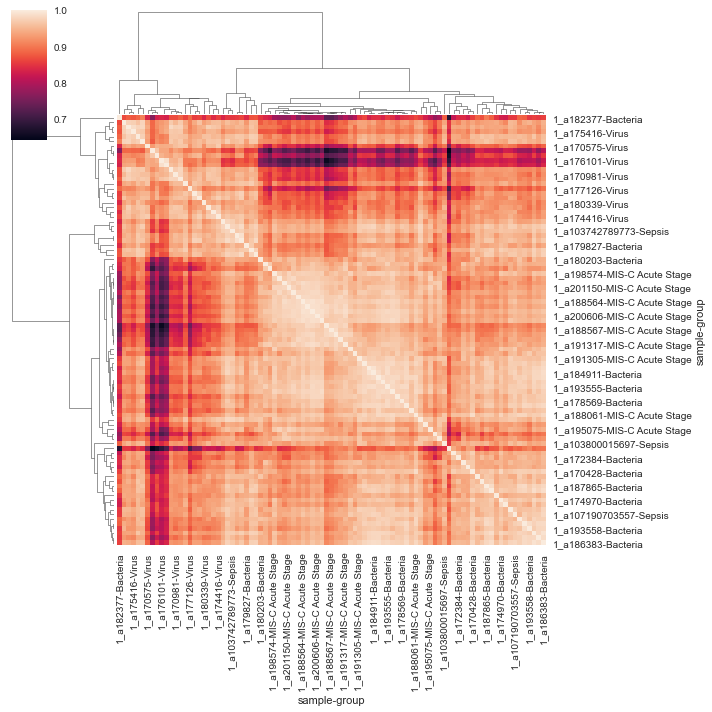

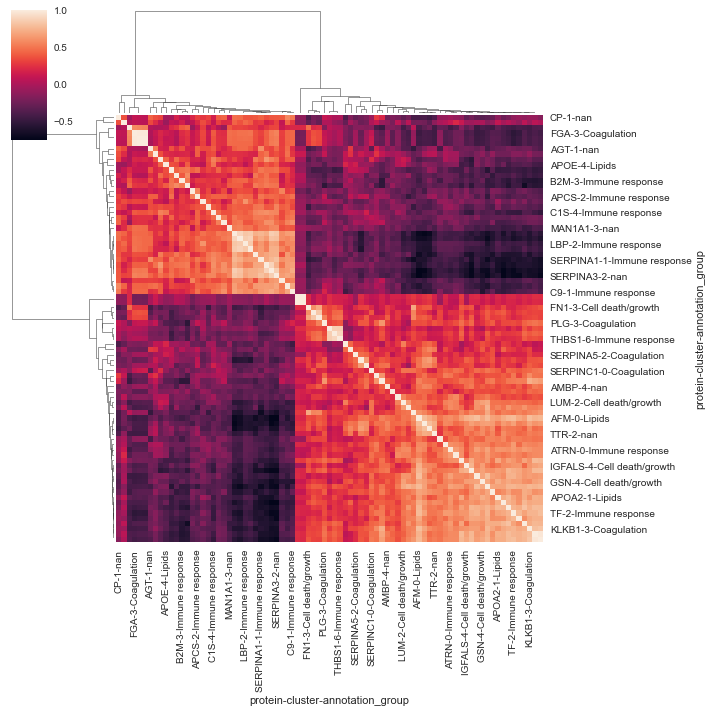

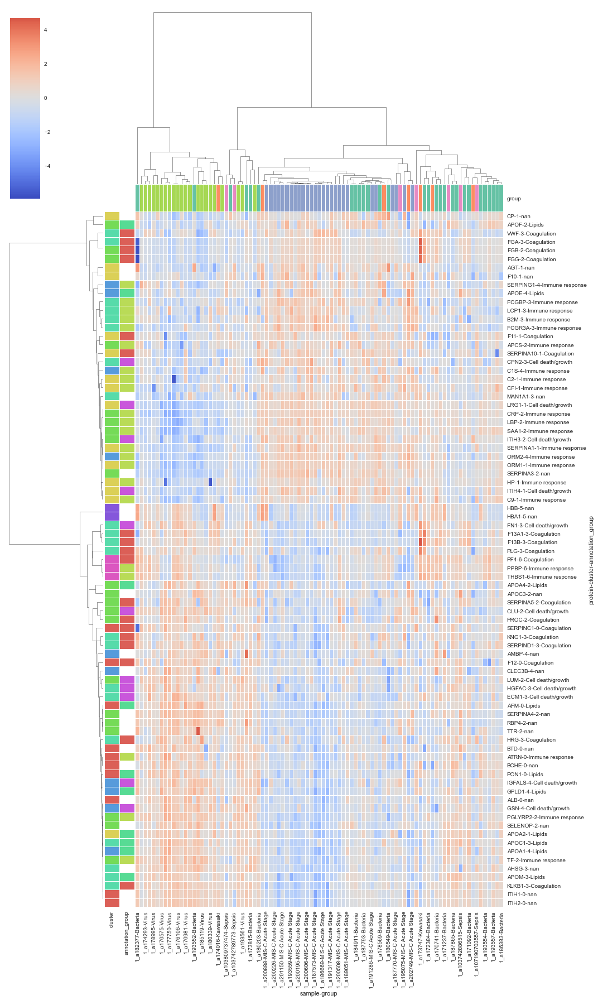

In [457]:
col_linkage = sns.clustermap(heatmap2.corr(), metric = 'correlation').dendrogram_col.linkage
row_linkage = sns.clustermap(heatmap2.T.corr(), metric = 'correlation').dendrogram_col.linkage

g = sns.clustermap(heatmap2, z_score = 0,
                   figsize=(15, 25), col_colors = group_colors, row_colors = annotation_cluster_colors,
                   #col_cluster=False,
                   col_linkage=col_linkage, 
                   row_linkage = row_linkage,
                   linewidth=0.5, linecolor='white', cmap = 'coolwarm', center = 0)

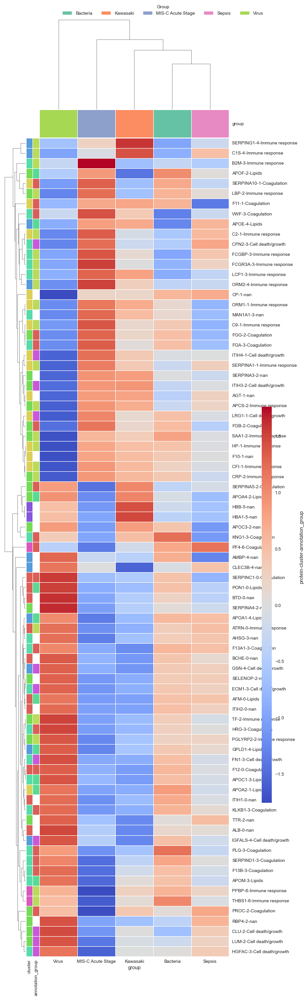

In [458]:
# Heatmap of protein expression median
heatmap_condensed = heatmap2.T.groupby('group').median().T

# grouping colors
group_labels = heatmap_condensed.columns.get_level_values("group")
group_pal = sns.color_palette('Set2',group_labels.unique().size)
group_lut = dict(zip(map(str, group_labels.unique()), group_pal))
# create group index
group_pid_colors = pd.Series(group_labels, index=heatmap_condensed.columns).map(group_lut)

# correlation colors
correlation_labels = heatmap_condensed.index.get_level_values("cluster")
corr_pal = sns.hls_palette(correlation_labels.unique().size)
corr_lut = dict(zip(map(str, correlation_labels.unique()), corr_pal))
# create correlation index
correlation_colors = pd.Series(correlation_labels, index=heatmap_condensed.index).map(corr_lut)

# annotation colors
annotation_labels = heatmap_condensed.index.get_level_values("annotation_group")
corr_pal = sns.hls_palette(annotation_labels.unique().size)
corr_lut = dict(zip(map(str, annotation_labels.unique()), corr_pal))
# create correlation index
annotation_colors = pd.Series(annotation_labels, index=heatmap_condensed.index).map(corr_lut)

# combine column colors:
annotation_cluster_colors = pd.DataFrame(correlation_colors).join(pd.DataFrame(annotation_colors))


g = sns.clustermap(heatmap_condensed, z_score=0, col_cluster=True, #row_cluster = False,
               figsize=(10, 30), col_colors = group_pid_colors, row_colors = annotation_cluster_colors, 
               linewidth=0.5, cmap = "coolwarm", center = 0,dendrogram_ratio=0.1, metric = 'euclidean')

# add legends
for label in group_labels.unique():
    g.ax_col_dendrogram.bar(0, 0, color=group_lut[label], label=label, linewidth=0);
l1 = g.ax_col_dendrogram.legend(title='Group', loc="center", ncol=7, bbox_to_anchor=(0.5, 1), bbox_transform=gcf().transFigure)
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.8, .2, .03, .4))
g.figure.savefig("/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/heatmap_sign_median_annotation.pdf")

### GO enrichment

In [459]:
annotation_query = 'MATCH (p:Protein)-[r:ASSOCIATED_WITH]-(bp:Biological_process) WHERE (p.name) IN [{}] RETURN DISTINCT (p.name +"~"+p.id) AS identifier, bp.name AS annotation'
prots = ["'{}'".format(p) for p in candidates]

from ckg.graphdb_connector import connector

driver = connector.getGraphDatabaseConnectionConfiguration()
annotation = connector.getCursorData(driver, annotation_query.format(",".join(prots)))

In [460]:
enrichment = analytics.run_up_down_regulation_enrichment(anova2, annotation,
                                                         identifier='identifier', groups=['group1', 'group2'],
                                                         annotation_col='annotation', reject_col='rejected',
                                                         group_col='group', method='fisher',
                                                         correction='fdr_bh', alpha=0.05, lfc_cutoff=1)

In [461]:
enrich_df = enrichment['Not MIS-C~MIS-C Acute Stage']
enrich_df.loc[enrich_df.rejected].to_csv(root_dir+'/output/GOBP_notmisc_table.tsv', sep = '\t')

identifier='enrichment'
enrichment_results = enrichment
for g in enrichment:
    g1, g2 = g.split('~')
    group = 'direction'
    nid = identifier+'_{}_{}'.format(g1, g2)
    df = enrichment_results[g][enrichment_results[g].rejected]
    df = df.sort_values(by=[group, 'padj'], ascending=False)
    df['x'] = -np.log10(df['padj'])
    
fig = px.scatter(df.loc[df.rejected==True], x = 'x',y='terms', color = 'direction', template='plotly_white',
                 category_orders = {'direction':['downregulated','upregulated']}, height = 500)
fig.update_xaxes(linewidth=2, linecolor='lightgrey', gridcolor='lightgrey', zeroline=True, zerolinecolor='lightgrey')
fig.update_yaxes(linewidth=2, linecolor='lightgrey',gridcolor='lightgrey',zeroline=True, zerolinecolor='lightgrey')
#fig.update_xaxes(range=[1.3, 1.75])
#fig.update_yaxes(range=[0, 14.5])
fig.update_layout(
    title="GOBP enrichment: MIS-C Acute Stage vs Control Groups",
    xaxis_title="-log10(padj)",
    yaxis_title="Enriched terms",
    legend_title="")
fig.write_image(root_dir+'/output/GOBP_notmisc.pdf', height = 500, width = 1000)
fig.show()

In [462]:
enrich_annotation = enrich_df[['terms','identifiers','direction']].drop_duplicates().reset_index(drop = True)
identifiers = enrich_annotation.identifiers.str.split(',', expand = True)[0].tolist()+enrich_annotation.identifiers.str.split(',', expand = True)[1].tolist()+enrich_annotation.identifiers.str.split(',', expand = True)[2].tolist()
enrich_explode = pd.concat([enrich_annotation[['terms','direction']],enrich_annotation[['terms','direction']],enrich_annotation[['terms','direction']]])
enrich_explode['identifier']=identifiers
enrich_explode['protein']=enrich_explode.identifier.str.split('~', expand = True)[0]
enrich_explode.dropna().sort_values(['protein','terms'])

,terms,direction,identifier,protein
1,immune response,upregulated,B2M~P61769,B2M
0,acute-phase response,upregulated,CRP~P02741,CRP
4,defense response to Gram-positive bacterium,upregulated,CRP~P02741,CRP
5,innate immune response,upregulated,CRP~P02741,CRP
2,opsonization,upregulated,CRP~P02741,CRP
1,immune response,upregulated,FCGR3A~P08637,FCGR3A
14,negative regulation of cell population prolife...,downregulated,GPLD1~P80108,GPLD1
9,positive regulation of endothelial cell migration,downregulated,GPLD1~P80108,GPLD1
12,response to glucose,downregulated,GPLD1~P80108,GPLD1
0,acute-phase response,upregulated,LBP~P18428,LBP


In [463]:
print(enrich_explode['protein'].unique().tolist())

['CRP', 'B2M', 'SAA1', 'PF4', 'GPLD1', 'LBP', 'FCGR3A', 'VWF', 'PPBP', 'THBS1', None]


In [464]:
annotation_df.loc[annotation_df.protein.isin(enrich_explode.protein.unique().tolist())]

,Identifier,Tabel 2,Annelaura cathegorizaion,Comments,Explanation,T.statistics,log2FC,padj,FC,X.log10.pvalue,color,name,annotation_group,protein
17,B2M~P61769,Ja,Immune response,Inflam,Beta-2-microglobulin.,5.822328,1.187872,2.411438e-06,2.278164,6.591917,indianred,B2M,Immune response,B2M
33,CRP~P02741,Ja,Immune response,Inflam,CRP :) bedste inflammationsmarkør,7.457523,2.614822,1.882175e-09,6.125477,10.114506,indianred,CRP,Immune response,CRP
40,FCGR3A~P08637,Ja,Immune response,Inflam (IgG binding protein),Fc fragment of IgG receptor IIIa,9.153274,1.119075,8.662509e-11,2.172077,12.150492,indianred,FCGR3A,Immune response,FCGR3A
47,GPLD1~P80108,NaN,Lipids,Lipids,Phosphatidylinositol-glycan-specific phospholi...,-6.669784,-1.131477,2.515877e-07,0.456448,7.733204,lightsteelblue,GPLD1,Lipids,GPLD1
75,LBP~P18428,Ja,Immune response,Innate immunsystem,Lipopolysaccharide-binding protein,5.583433,1.065603,3.019622e-06,2.093045,6.462055,indianred,LBP,Immune response,LBP
84,PF4~P02776,Ja,Coagulation,Koag,Platelet factor 4. Neutraliserer heparin. Chem...,-4.420746,-1.476548,3.008265e-04,0.359348,4.257637,lightsteelblue,PF4,Coagulation,PF4
89,PPBP~P02775,Nej,Immune response,Inflam/koag,"CXCL7, Pro-platelet basic protein, chemokin - ...",-5.266853,-1.728823,2.805971e-05,0.301698,5.422569,lightsteelblue,PPBP,Immune response,PPBP
93,SAA1~P0DJI8,Nej,Immune response,Inflam,Serum amyloid A,4.622749,1.810145,8.445875e-05,3.506775,4.894320,indianred,SAA1,Immune response,SAA1
107,THBS1~P07996,Nej,Immune response,Inflam,"Glykoprotein, CD47 ligand, celleoverflade (adh...",-5.777930,-1.363695,3.314802e-06,0.388586,6.406310,lightsteelblue,THBS1,Immune response,THBS1
110,VWF~P04275,Ja,Coagulation,Koag,Von Willebrand Factor,4.099148,1.196878,6.027867e-04,2.292430,3.910032,indianred,VWF,Coagulation,VWF


In [465]:
anova2.loc[anova2.rejected == True].to_csv(root_dir+'/output/sign_table.tsv', sep='\t', index = False)
print(anova2.loc[anova2.rejected == True].shape)

(105, 19)


# ML

### Misc vs febrile controls

In [466]:
processed_data['combination']=np.nan
processed_data.loc[processed_data.group.isin(['Virus','Bacteria']),'combination']='VB'
processed_data.loc[processed_data.group == 'MIS-C Acute Stage','combination']='MIS-C Acute Stage'

In [467]:
from sklearn.model_selection import train_test_split, StratifiedKFold#, RandomizedSearchCV, StratifiedKFold, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, matthews_corrcoef, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, classification_report, roc_curve
from scipy import interp
import plotly.graph_objects as go
#from yellowbrick.model_selection import RFECV

In [468]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix, matthews_corrcoef, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, classification_report, roc_curve

from sklearn.linear_model import LogisticRegressionCV
from sklearn.model_selection import train_test_split, RandomizedSearchCV, StratifiedKFold, cross_val_score
from sklearn.feature_selection import RFECV


import numpy as np
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, ExtraTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn import ensemble
from sklearn.linear_model import Perceptron

from scipy.stats import uniform, truncnorm, randint

import time

n_features = processed_data.drop(['sample','subject','group','combination'], axis = 1).shape[1]
n_samples = int(processed_data.shape[0]*0.8)


# hyperparameter grids
lr_grid = {"C": [0.1, 0.5, 1],#np.logspace(0, 4, num=10),
           "penalty": ['l1', 'l2','elasticnet'],
           "solver": ['liblinear', 'saga'],
           "max_iter":[5000]}
lda_grid = {"solver": ['svd', 'lsqr', 'eigen'],
            "shrinkage":[None, 'auto']}
knn_grid = {"n_neighbors": randint(1,11),
            "weights":['uniform','distance'], 
            "algorithm":['auto','ball_tree','kd_tree','brute'], 
            "leaf_size":randint(10,50), 
            "p":[1,2],
            "metric":['euclidean','minkowski','mahalanobis','seuclidean']}
dt_grid = {"criterion": ["gini", "entropy"],
            "splitter": ['best','random'],
            #"max_features": randint(1, n_features),
            "min_samples_leaf": randint(1, 11),
            "class_weight":[None, 'balanced']}
nb_grid = {}
svc_grid = {"kernel": ['linear'], #'poly', 'rbf', 'sigmoid'], #removed because it does not work with importance getter
            "gamma":['scale','auto'],
            "class_weight" : ['balanced',None],
            "probability" : [True]}
rf_grid = {"max_depth": [3, None],
            "min_samples_split": randint(1, 11),
            "min_samples_leaf": randint(1, 11),
            "bootstrap": [True, False],
            "criterion": ["gini", "entropy"],
            "n_estimators": randint(1,200),
            "max_features": truncnorm(a=0, b=1, loc=0.25, scale=0.1)}
nnet_grid = {"hidden_layer_sizes":randint(1,n_features),
            "activation": ['identity','logistic','tanh','relu'],
            "solver":['lbfgs','sgd','adam'],
            "batch_size":[int(n_samples/10),int(n_samples/5), int(n_samples/2)],
            "learning_rate_init":np.logspace(np.log10(0.00001), np.log10(0.99999), num=10),
            "max_iter":[5000],
            "early_stopping":[True],
            "validation_fraction":[0.25]}
perceptron_grid = {"penalty": ['l1', 'l2','elasticnet'],
                   "max_iter":[5000],
                   "class_weight" : ['balanced',None]}
                   
gp_grid = {}
ab_grid = {}
qda_grid = {}
eet_grid = {}

# models
models = []
models.append(('LR', lr_grid, LogisticRegression(random_state=7)))
models.append(('LDA', lda_grid, LinearDiscriminantAnalysis()))
models.append(('KNN', knn_grid, KNeighborsClassifier()))
models.append(('DT', dt_grid, DecisionTreeClassifier(random_state=7)))
models.append(('Naive Bayes', nb_grid, GaussianNB()))
models.append(('SVC', svc_grid, SVC(random_state=7)))
models.append(('RF', rf_grid, RandomForestClassifier(random_state=7)))
models.append(('NNet', nnet_grid, MLPClassifier(random_state=7)))
#models.append(('Perceptron',perceptron_grid,Perceptron(random_state = 7)))
models.append(('GP', gp_grid, GaussianProcessClassifier(random_state=7)))
models.append(('Adaboost', ab_grid, AdaBoostClassifier(random_state=7)))
models.append(('QDA', qda_grid, QuadraticDiscriminantAnalysis()))
models.append(('ensembleextratree', eet_grid, ensemble.ExtraTreesClassifier(random_state=7)))
#import xgboost as xgb
#models.append(('xgb',xgb_grid,xgb.Data))

### Prepare ML data

In [574]:
new_df = processed_data.copy()
new_df['grouping1']=new_df['group'].copy()
new_df.loc[new_df.combination.notnull(),'grouping1']=new_df.loc[new_df.combination.notnull()].combination.tolist()
new_df['study']=new_df.grouping1.copy()
new_df.loc[new_df.study.isin(['MIS-C Acute Stage','VB']),'study']='train'

drop_cols=['sample','subject','group','grouping1','study','combination','grouping2'] 
protein_cols = [col for col in new_df.columns.tolist() if col not in drop_cols]
prepared_data = new_df.copy()
prepared_data[protein_cols]=zscore(prepared_data[protein_cols], axis = 1)
train_data = prepared_data.loc[prepared_data.study=='train']


#run_ml(new_df, train_label = 'train', drop_cols=['sample','subject','group','grouping1'])
# prepare for classification
no_cv = 5
X = train_data[protein_cols].values # all the protein columns
sample_lst = train_data['sample'].values
y = train_data.grouping1.astype('category').cat.codes.values # 0: Negative, 1: Positive
#X_train, X_test, y_train, y_test, samples_train, samples_test = train_test_split(X, y, train_data['sample'].tolist(), test_size=0.2, random_state=7, stratify=y)
X_train = X.copy()
y_train = y.copy()

In [575]:
val_data = prepared_data.loc[prepared_data.study!='train']
val_data['y']='VB'
val_data.loc[val_data.grouping1=='MIS-C During Admission','y']='MIS-C During Admission'
X_val = val_data[protein_cols].values
y_val = val_data.y.astype('category').cat.codes.values
sum(y_val)

23

### ML alg. selection and feature elimination


In [49]:
# ML alg. selection
optimal_models = []
optimal_no_features = []
optimal_features = []
start_time = time.time()

dfs = []
metrics = []
to_plot = []   
fitted_models = []
    
for name, grid, estimator in models:
    print(name)
    # grid search
    selector = RandomizedSearchCV(estimator=estimator, param_distributions=grid, cv=StratifiedKFold(no_cv), scoring = 'f1_weighted', n_jobs = -1)
    clf = selector.fit(X_train,y_train)
    optimal_model = clf.best_estimator_
    optimal_models.append(optimal_model)
    # feature reduction
    if name in ['Naive Bayes','NNet', 'GP', 'QDA', 'KNN']: # skip rfecv for models not supported by importance
        optimal_no_features.append(len(protein_cols))
        optimal_features.append(protein_cols)
        print('skipping feature importance')
        X_reduced = X_train
        X_val_reduced = X_val
    else:
        selector = RFECV(optimal_model, cv=5, scoring='f1_weighted')
        selector = selector.fit(X_train, y_train)
        optimal_no_features.append(sum(selector.support_))
        optimal_features.append(list(compress(protein_cols, selector.support_)))
        print('optimal no features = {}'.format(sum(selector.support_)))
        X_reduced = X_train[:,selector.support_]
        X_val_reduced = X_val[:, selector.support_]
    
    # compute cv results
    print('computing predictions for: {}'.format(name))
    classifier = optimal_model
    mccs = []
    aucs = []
    fits = []
    mcc_val = []
    auc_val = []
                            
    # calculate performance during training
    cv = StratifiedKFold(n_splits=no_cv)
    for i, (train, test) in enumerate(cv.split(X_reduced, y_train)):
        print('cv: {}'.format(i+1))
        classifier.fit(X_reduced[train], y_train[train])
        
        fits.append(classifier)
        # predict for "test" set
        y_pred = classifier.predict(X_reduced[test])
        y_prob = classifier.predict_proba(X_reduced[test])[:,1]
        result = pd.DataFrame([y_train[test], y_pred, y_prob]).T
        result.columns = ['observed','predicted','probability']
        result['cv']=i+1
        result['model']=name
        result['sample']=sample_lst[test]
        result['run']='test'
        dfs.append(result)
        mccs.append(round(matthews_corrcoef(result.observed, result.predicted),2))
        aucs.append(round(roc_auc_score(result.observed,result.probability),2))
        # predict for validation sets
        y_pred = classifier.predict(X_val_reduced)
        y_prob = classifier.predict_proba(X_val_reduced)[:,1]
        result = pd.DataFrame([y_val, y_pred, y_prob]).T
        result.columns = ['observed','predicted','probability']
        result['cv']=i+1
        result['model']=name
        result['sample']=val_data['sample'].tolist()
        result['run']='val'
        dfs.append(result)  
        mcc_val.append(round(matthews_corrcoef(result.observed, result.predicted),2))
        auc_val.append(round(roc_auc_score(result.observed,result.probability),2))      
        
    fitted_models.append(fits)
    #test
    metrics_results = pd.DataFrame(mccs)
    metrics_results.columns = ['MCC']
    metrics_results['AUROC']=aucs
    metrics_results['cv']=list(range(1,1+no_cv))
    metrics_results['model']=name
    metrics_results['run']='test'
    metrics.append(metrics_results)

    #val
    metrics_results = pd.DataFrame(mccs)
    metrics_results.columns = ['MCC']
    metrics_results['AUROC']=aucs
    metrics_results['cv']=list(range(1,1+no_cv))
    metrics_results['model']=name
    metrics_results['run']='val'
    metrics.append(metrics_results)
    
    mcc_mean = np.mean(mccs)
    mcc_std = np.std(mccs)
    auroc_mean = np.mean(aucs)
    auroc_std = np.std(aucs)
    to_plot.append([name, mcc_mean, mcc_std, auroc_mean, auroc_std])
    print('MCC: {}, AUROC: {}'.format(mcc_mean, auroc_mean))
    
    print('\n{} model tested --- {} minutes ---\n'.format(name,round(((time.time() - start_time)/60),3)))


result_df = pd.concat(dfs)
metrics_df = pd.concat(metrics)


LR


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:972: UserWarning:

One or more of the test scores are non-finite: [0.85566695        nan        nan 0.89451204        nan 0.87957133
 0.89451204 0.89451204 0.87957133 0.53897436]



optimal no features = 3
computing predictions for: LR
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.924, AUROC: 0.984

LR model tested --- 0.134 minutes ---

LDA


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 6 is smaller than n_iter=10. Running 6 iterations. For exhaustive searches, use GridSearchCV.

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:972: UserWarning:

One or more of the test scores are non-finite: [0.94727273 0.43916701        nan        nan 0.94778765 0.94778765]



optimal no features = 6
computing predictions for: LDA
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.8960000000000001, AUROC: 1.0

LDA model tested --- 0.356 minutes ---

KNN


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:972: UserWarning:

One or more of the test scores are non-finite: [       nan        nan 0.89525734        nan 0.83517769        nan
        nan 0.84375421        nan 0.89264948]



skipping feature importance
computing predictions for: KNN
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.798, AUROC: 0.942

KNN model tested --- 0.36 minutes ---

DT
optimal no features = 178
computing predictions for: DT
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.876, AUROC: 0.9480000000000001

DT model tested --- 0.378 minutes ---

Naive Bayes
skipping feature importance
computing predictions for: Naive Bayes
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.784, AUROC: 0.9620000000000001

Naive Bayes model tested --- 0.379 minutes ---

SVC


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 4 is smaller than n_iter=10. Running 4 iterations. For exhaustive searches, use GridSearchCV.



optimal no features = 4
computing predictions for: SVC
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 1.0, AUROC: 1.0

SVC model tested --- 0.406 minutes ---

RF
optimal no features = 68
computing predictions for: RF
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.7860000000000001, AUROC: 0.992

RF model tested --- 0.991 minutes ---

NNet
skipping feature importance
computing predictions for: NNet
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.8300000000000001, AUROC: 0.9800000000000001

NNet model tested --- 1.002 minutes ---

GP
skipping feature importance
computing predictions for: GP
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.766, AUROC: 0.884

GP model tested --- 1.004 minutes ---

Adaboost


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.



optimal no features = 7
computing predictions for: Adaboost
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.8619999999999999, AUROC: 0.976

Adaboost model tested --- 1.923 minutes ---

QDA
skipping feature importance
computing predictions for: QDA
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.274, AUROC: 0.646

QDA model tested --- 1.924 minutes ---

ensembleextratree


/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/model_selection/_search.py:296: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning:

Variables are collinear

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning:

Variables are collinear

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning:

Variables are collinear

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning:

Variables are collinear

/Users/tzx804/opt/miniconda3/envs/ckgenv/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning:

Variables are collinear

/Users/tzx804/opt/mini

optimal no features = 174
computing predictions for: ensembleextratree
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.776, AUROC: 0.984

ensembleextratree model tested --- 2.895 minutes ---



In [202]:
plot_df = pd.DataFrame(to_plot)
plot_df.columns=['model','mcc_mean','mcc_std','auroc_mean','auroc_std']
plot_df = round(plot_df,2)
plot_df['no_features']=[len(x) for x in optimal_features]
plot_df['features']=optimal_features
plot_df = plot_df.sort_values('mcc_mean').reset_index(drop = True)
plot_df

,model,mcc_mean,mcc_std,auroc_mean,auroc_std,no_features,features
0,QDA,0.27,0.28,0.65,0.15,179,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
1,GP,0.77,0.09,0.88,0.14,179,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
2,Naive Bayes,0.78,0.11,0.96,0.05,179,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
3,ensembleextratree,0.78,0.08,0.98,0.01,174,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
4,RF,0.79,0.06,0.99,0.01,68,"[C4BPB~P20851, C4B~P0C0L5, C5~P01031, C6~P1367..."
5,KNN,0.80,0.05,0.94,0.05,179,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
6,NNet,0.83,0.12,0.98,0.02,179,"[A1BG~P04217, A2M~P01023, ACTA2~P62736, ACTBL2..."
7,Adaboost,0.86,0.15,0.98,0.04,7,"[C1QB~P02746, FCGR3A~P08637, LCP1~P13796, ORM1..."
8,DT,0.88,0.07,0.95,0.03,178,"[A2M~P01023, ACTA2~P62736, ACTBL2~Q562R1, ACTB..."
9,LDA,0.90,0.09,1.00,0.00,6,"[C5~P01031, CPN2~P22792, FCGR3A~P08637, GC~P02..."


In [239]:
popularity = plot_df.explode('features')
popularity['frequency'] = popularity.features.map(popularity.features.value_counts())
popularity['feature_imp']=1/popularity['no_features']
popularity_summed = pd.DataFrame(popularity.groupby('features').feature_imp.sum()).reset_index()
popularity_summed.columns = ['features','sum_imp']
popularity_summed['sum_rel']=100*(popularity_summed.sum_imp/11.0)
print(sum(popularity_summed.sum_rel))
popularity_summed.sort_values('sum_imp', ascending = False).head(10)

109.09090909090914


,features,sum_imp,sum_rel
84,FCGR3A~P08637,0.946861,8.607828
121,LCP1~P13796,0.780194,7.092677
160,SERPINA3~P01011,0.446861,4.062374
83,FCGBP~Q9Y6R7,0.387337,3.521248
32,BCHE~P06276,0.289298,2.629982
117,KLKB1~P03952,0.220671,2.006096
46,C5~P01031,0.220671,2.006096
159,SERPINA1~P01009,0.220671,2.006096
69,CPN2~P22792,0.220671,2.006096
93,GC~P02774,0.205965,1.872407


In [240]:
popularity_overview = pd.DataFrame(popularity[['model','features','frequency']].groupby(['features','frequency']).model.apply(list)).sort_values('frequency',ascending = False)
popularity_overview.head(10)


,,model
features,frequency,
FCGR3A~P08637,12,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
LCP1~P13796,11,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
SERPINA3~P01011,10,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
SERPINA1~P01009,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
CPN2~P22792,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
FCGBP~Q9Y6R7,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
KLKB1~P03952,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
C5~P01031,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
ORM1~P02763,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."


In [242]:
pd.merge(popularity_summed,popularity_overview.reset_index()).sort_values('sum_rel', ascending = False)

,features,sum_imp,sum_rel,frequency,model
84,FCGR3A~P08637,0.946861,8.607828,12,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
121,LCP1~P13796,0.780194,7.092677,11,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
160,SERPINA3~P01011,0.446861,4.062374,10,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
83,FCGBP~Q9Y6R7,0.387337,3.521248,9,"[QDA, GP, Naive Bayes, ensembleextratree, RF, ..."
32,BCHE~P06276,0.289298,2.629982,8,"[QDA, GP, Naive Bayes, ensembleextratree, KNN,..."
...,...,...,...,...,...
78,F13B~P05160,0.039298,0.357255,7,"[QDA, GP, Naive Bayes, ensembleextratree, KNN,..."
0,A1BG~P04217,0.033680,0.306183,6,"[QDA, GP, Naive Bayes, ensembleextratree, KNN,..."
76,F12~P00748,0.033551,0.305009,6,"[QDA, GP, Naive Bayes, KNN, NNet, DT]"
102,HBD~P02042,0.033551,0.305009,6,"[QDA, GP, Naive Bayes, KNN, NNet, DT]"


# the most important proteins must be FCGR3A followed by LCP1 and SERPINA3

Make butterfly plot where the result from each model comes from
1) selection of optimal hyperparameters
2) subsequent feature reduction
Remember cv and remember no_features listed next to the models.

In [205]:
def butterfly_plot(df, var1, var2, var3, error1, error2, name, savepdf=True, group = 'model'):
    fig = make_subplots(rows=1, cols=2, specs=[[{}, {}]], shared_xaxes=False, shared_yaxes=True, horizontal_spacing=0)
    fig.append_trace(go.Bar(x = df[var1], y = df[group], text = df[var1], error_x=dict(type='data', array=df[error1]), error_y=dict(type='data', array=df[error1]),
                        textposition='inside', orientation='h', width=0.7, 
                        showlegend=False, marker_color='#4472c4'), 1, 1) # 1,1 represents row 1 column 1
    fig.append_trace(go.Bar(x = df[var2], y = df[group], text = df[var2], error_x=dict(type='data', array=df[error2]), error_y=dict(type='data', array=df[error2]),
                 textposition='inside', orientation='h', width=0.7, 
                 showlegend=False, marker_color='#ed7d31'), 1, 2) # 1,2 represents row 1 column 2
    fig.update_xaxes(title_text="Matthews Correlation Coefficient", row=1, col=1, range=[1,0])
    fig.update_xaxes(title_text="AUROC", row=1, col=2)
    fig.update_layout(width=800, height=700, title_x=0.5,xaxis1={'side': 'top'},xaxis2={'side': 'top'},)
    fig.update_layout(template='plotly_white')
    if savepdf:
        fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/alg_butterfly_{}.pdf'.format(name))
    fig.show()

In [206]:
plot_df['model_n_features']= ['{} (no. proteins = {})'.format(plot_df.loc[i,'model'],plot_df.loc[i,'no_features']) for i in plot_df.index.tolist()]


In [207]:
from plotly.subplots import make_subplots
butterfly_plot(plot_df, var1 = 'mcc_mean', var2 = 'auroc_mean', var3 = 'no_features', error1 = 'mcc_std', error2 = 'auroc_std', name = '040923', savepdf=True, group = 'model_n_features')


In [69]:
popularity.loc[popularity.model.isin(['LR','SVC','LDA','DT'])].sort_values(['frequency','features'], ascending = False).head(20)

,model,mcc_mean,mcc_std,auroc_mean,auroc_std,no_features,features,frequency,feature_imp
8,DT,0.88,0.07,0.95,0.03,178,FCGR3A~P08637,12,0.005618
9,LDA,0.90,0.09,1.00,0.00,6,FCGR3A~P08637,12,0.166667
10,LR,0.92,0.10,0.98,0.03,3,FCGR3A~P08637,12,0.333333
11,SVC,1.00,0.00,1.00,0.00,4,FCGR3A~P08637,12,0.250000
8,DT,0.88,0.07,0.95,0.03,178,LCP1~P13796,11,0.005618
10,LR,0.92,0.10,0.98,0.03,3,LCP1~P13796,11,0.333333
11,SVC,1.00,0.00,1.00,0.00,4,LCP1~P13796,11,0.250000
8,DT,0.88,0.07,0.95,0.03,178,SERPINA3~P01011,10,0.005618
11,SVC,1.00,0.00,1.00,0.00,4,SERPINA3~P01011,10,0.250000
8,DT,0.88,0.07,0.95,0.03,178,SERPINA1~P01009,9,0.005618


# plot feature selection for SVC

In [471]:
optimal_models[5]

SVC(class_weight='balanced', kernel='linear', probability=True, random_state=7)

In [472]:
selector = RFECV(optimal_models[5], cv=5, scoring='f1_weighted')
selector = selector.fit(X_train, y_train)

print(f"Optimal number of features: {selector.n_features_}")


Optimal number of features: 4


In [473]:
error_max = selector.cv_results_['mean_test_score']+selector.cv_results_['std_test_score']
error_min = selector.cv_results_['mean_test_score']-selector.cv_results_['std_test_score']

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=np.concatenate([list(range(1,len(protein_cols)+1)),list(range(1,len(protein_cols)+1))[::-1]]),
    y=np.concatenate([error_max, error_min[::-1]]),
    fill='toself', opacity=0.5, name = '1 std.'))
fig.add_trace(go.Scatter(x=list(range(1,len(protein_cols)+1)), y = selector.cv_results_['mean_test_score'],
                         name='Mean test score',line = dict(color='firebrick', width=1)))
fig.add_trace(go.Scatter(x = [selector.n_features_,selector.n_features_], name = 'Optimal number of features: {}'.format(selector.n_features_), 
                         y=[0,1], 
                         mode='lines', 
                         line=dict(color='green', width=2, dash='dash')))

fig.update_layout(template='simple_white',
    autosize=False,
    width=800,
    height=500,
    title="RFECV for SVC classifier",
    xaxis_title="Number of features selected",
    yaxis_title="F1-weighted",
    legend_title="",
    #legend=dict(y=1.1, orientation='h'),
    legend_traceorder="reversed",
    xaxis_range=[0,179],
    yaxis_range = [0,max(error_max)])

fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/RFECV_SVC.pdf')
fig.show()

In [576]:
X_train = X_train[:, selector.support_]
X_val = X_val[:, selector.support_]


In [578]:
# compute cv results
print('computing predictions for: {}'.format(optimal_models[5]))
classifier = optimal_models[5]
name = 'SVC'
mccs = []
aucs = []
fits = []
mcc_val = []
auc_val = []
dfs = []
                        
# calculate performance during training
cv = StratifiedKFold(n_splits=no_cv)
for i, (train, test) in enumerate(cv.split(X_train, y_train)):
    print('cv: {}'.format(i+1))
    classifier.fit(X_train[train], y_train[train])
    calibrated = CalibratedClassifierCV(classifier, method='sigmoid', cv=5)
    calibrated.fit(X_train[train], y_train[train])
    classifier = calibrated
    fits.append(classifier)
    # predict for "test" set
    y_pred = classifier.predict(X_train[test])
    y_prob = classifier.predict_proba(X_train[test])[:,1]
    result = pd.DataFrame([y_train[test], y_pred, y_prob]).T
    result.columns = ['observed','predicted','probability']
    result['cv']=i+1
    result['model']=name
    result['sample']=sample_lst[test]
    result['run']='test'
    dfs.append(result)
    mccs.append(round(matthews_corrcoef(result.observed, result.predicted),2))
    aucs.append(round(roc_auc_score(result.observed,result.probability),2))
    # predict for validation sets
    y_pred = classifier.predict(X_val)
    y_prob = classifier.predict_proba(X_val)[:,1]
    result = pd.DataFrame([y_val, y_pred, y_prob]).T
    result.columns = ['observed','predicted','probability']
    result['cv']=i+1
    result['model']=name
    result['sample']=val_data['sample'].tolist()
    result['run']='val'
    dfs.append(result)  
    mcc_val.append(round(matthews_corrcoef(result.observed, result.predicted),2))
    auc_val.append(round(roc_auc_score(result.observed,result.probability),2))      
    
mcc_mean = np.mean(mccs)
mcc_std = np.std(mccs)
auroc_mean = np.mean(aucs)
auroc_std = np.std(aucs)
to_plot.append([name, mcc_mean, mcc_std, auroc_mean, auroc_std])
print('Test: MCC: {}, AUROC: {}'.format(mcc_mean, auroc_mean))
print('Validation: MCC: {}, AUROC: {}'.format(np.mean(mcc_val), np.mean(auc_val)))

result = pd.concat(dfs)


computing predictions for: SVC(class_weight='balanced', kernel='linear', probability=True, random_state=7)
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
Test: MCC: 0.974, AUROC: 1.0
Validation: MCC: 0.63, AUROC: 0.932


In [474]:
print('Validation: MCC: {}, AUROC: {}'.format(np.mean(mcc_val), np.mean(auc_val)))


In [493]:
result_df = pd.concat(dfs)
result_df

,observed,predicted,probability,cv,model,sample,run
0,1.0,1.0,0.862589,1,SVC,1_a170428,test
1,1.0,1.0,0.980976,1,SVC,1_a170575,test
2,1.0,1.0,0.604177,1,SVC,1_a170741,test
3,1.0,1.0,0.868020,1,SVC,1_a170981,test
4,1.0,1.0,0.588508,1,SVC,1_a171092,test
...,...,...,...,...,...,...,...
25,1.0,1.0,0.912087,5,SVC,1_a191300,val
26,1.0,1.0,0.910652,5,SVC,1_a191303,val
27,0.0,0.0,0.135026,5,SVC,1_a191366,val
28,1.0,1.0,0.779448,5,SVC,1_a193562,val


In [579]:
fig = go.Figure()
# ROC for TEST
svc_test = result_df.loc[(result_df.model == 'SVC')&(result_df.run == 'test')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_test.loc[svc_test.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'TEST auc = {} (std. = {}), mcc = {} (std. = {}))'.format(auc_mean*100, np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='grey', width=2, dash='dash')))
# ROC for val
svc_val = result_df.loc[(result_df.model == 'SVC')&(result_df.run == 'val')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_val.loc[svc_val.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'val auc = {} (std. = {}), mcc = {} (std. = {})'.format(np.round(auc_mean*100,2), np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='green', width=2)))




fig.update_layout(template='simple_white',
    autosize=False,
    width=900,
    height=500,
    title="RFECV for SVC classifier",
    xaxis_title="Number of features selected",
    yaxis_title="F1-weighted",
    legend_title="",
    #legend=dict(y=1.1, orientation='h'),
    legend_traceorder="reversed",
    xaxis_range=[0,1],
    yaxis_range = [0,1])

fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_AUC.pdf', width = 850)
fig.show()

1.0
1.0
1.0
1.0
1.0
0.9192546583850932
0.9440993788819877
0.9316770186335405
0.9316770186335405
0.9440993788819877


# Prediction probabilities

In [497]:
result_svc = result_df.loc[result_df.model == 'SVC']
result_svc = pd.merge(result_svc,processed_data[['sample','group']], on = 'sample')
result_svc.probability = 100*(1-result_svc.probability)
result_svc.group.value_counts()


MIS-C Full Recovery       45
Sepsis                    35
Kawasaki                  35
MIS-C During Admission    35
Bacteria                  28
MIS-C Acute Stage         27
Virus                     22
Name: group, dtype: int64

In [498]:
fig = px.box(result_svc, x = 'probability', y = 'group', color = 'group', template = 'simple_white',
      height = 800, width = 900, points = "all",
      category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']}, 
      color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"])
fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_proba.pdf')
fig.show()

In [504]:
for g in ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']:
    sub = result_svc.loc[result_svc.group == g]
    print(g)
    print('mean prob. = {}'.format(np.round(np.mean(sub.probability),2)))
    print('IQR = {}\n'.format(np.round(np.quantile(sub.probability, 0.75)-np.quantile(sub.probability, 0.25),2)))
    #print('2std. prob. = {}\n'.format(np.round(2*np.std(sub.probability),2)))

MIS-C Acute Stage
mean prob. = 79.07
IQR = 11.8

MIS-C During Admission
mean prob. = 83.71
IQR = 8.37

MIS-C Full Recovery
mean prob. = 7.79
IQR = 2.49

Virus
mean prob. = 11.06
IQR = 5.96

Bacteria
mean prob. = 15.19
IQR = 7.07

Sepsis
mean prob. = 32.94
IQR = 48.03

Kawasaki
mean prob. = 52.3
IQR = 49.29



In [506]:
for g in ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']:
    sub = result_mean.loc[result_mean.group == g]
    print(g)
    print('mean prob. = {}'.format(np.round(np.mean(sub.probability),2)))
    print('IQR = {}\n'.format(np.round(np.quantile(sub.probability, 0.75)-np.quantile(sub.probability, 0.25),2)))
    #print('2std. prob. = {}\n'.format(np.round(2*np.std(sub.probability),2)))

MIS-C Acute Stage
mean prob. = 79.07
IQR = 11.8

MIS-C During Admission
mean prob. = 83.71
IQR = 9.26

MIS-C Full Recovery
mean prob. = 7.79
IQR = 1.54

Virus
mean prob. = 11.06
IQR = 5.96

Bacteria
mean prob. = 15.19
IQR = 7.07

Sepsis
mean prob. = 32.94
IQR = 31.13

Kawasaki
mean prob. = 52.3
IQR = 43.68



In [513]:
# mean
result_mean = result_svc.groupby('sample').mean()
result_mean.reset_index(inplace = True)
result_mean = pd.merge(result_mean,processed_data[['sample','group']], on = 'sample')
#result_mean.probability = 100*(1-result_mean.probability)

fig = px.box(result_mean, x = 'probability', y = 'group', color = 'group', template = 'simple_white', points = 'all',
      category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']}, 
      color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"])
fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_proba_mean.pdf')
fig.show()

In [585]:
for g in result_mean.group.unique().tolist():
    sub = result_mean.loc[(result_mean.group == g)]
    print(g)
    print('mean prob. = {}'.format(np.round(np.mean(sub.probability),2)))
    print('median prob. = {}'.format(np.round(np.median(sub.probability),2)))
    print('IQR = {}\n'.format(np.round(np.quantile(sub.probability, 0.75)-np.quantile(sub.probability, 0.25),2)))
    #print('2std. prob. = {}\n'.format(np.round(2*np.std(sub.probability),2)))

Sepsis
mean prob. = 32.94
median prob. = 20.66
IQR = 31.13

Bacteria
mean prob. = 15.19
median prob. = 12.91
IQR = 7.07

Virus
mean prob. = 11.06
median prob. = 9.13
IQR = 5.96

Kawasaki
mean prob. = 52.3
median prob. = 55.75
IQR = 43.68

MIS-C Acute Stage
mean prob. = 79.07
median prob. = 82.97
IQR = 11.8

MIS-C During Admission
mean prob. = 83.71
median prob. = 87.67
IQR = 9.26

MIS-C Full Recovery
mean prob. = 7.79
median prob. = 7.28
IQR = 1.54



In [89]:
# LFQ

In [509]:
topfeatures_identifiers

['BCHE~P06276', 'FCGR3A~P08637', 'LCP1~P13796', 'SERPINA3~P01011']

In [510]:
lfq_plot = processed_data[['group']+topfeatures_identifiers]#+optimal_features[5]]
lfq_plot = pd.melt(lfq_plot, id_vars = 'group')
lfq_plot['protein']=lfq_plot.variable.str.split('~', expand = True)[0]

fig = px.box(lfq_plot, x = 'group',y='value', facet_col = 'protein', color = 'group', facet_col_wrap = 2,
      category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki'],
                      "protein": ['FCGR3A','LCP1','SERPINA3','BCHE']}, 
      color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"],
      template = 'simple_white', 
      height = 600, width = 700, facet_col_spacing=0.04,
      labels={"value": 'Protein expression (log10LFQ)',"group": ""})
fig.update_yaxes(matches=None)
fig.for_each_yaxis(lambda yaxis: yaxis.update(showticklabels=True))
fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_lfq.pdf', width = 700, height = 600)
fig.show()


In [512]:
from umap import UMAP
processed_sub = processed_data[['group']+topfeatures_identifiers] #+optimal_features[5]]

features = processed_sub.drop(['group'], axis = 1)

umap_2d = UMAP(n_components=2, init='random', random_state=0)

proj_2d = umap_2d.fit_transform(features)
proj_2d = pd.DataFrame(proj_2d)
proj_2d['group']=processed_sub.group.copy()

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color='group', labels={'color': 'group'}, 
    category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']},
    color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"],
    template = 'plotly_white', height = 500, width = 700
)

fig_2d.show()
#fig_2d.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/umap_SVC4.pdf')

# PRIDE

In [244]:
npx = pd.read_csv('/Users/tzx804/projects/collaborations/nicolai/misc/PRIDE/PXD029375/NPX_MISC_26OCT21.csv')
npx.DiseaseCat.replace({1:'MIS-C', 2:'Minimal COVID-19',3:'Severe COVID-19',4:'Healthy'}, inplace = True)

fig = px.box(npx.melt(id_vars=['SampleID','SubjectID','Timepoint','DiseaseCat']), x = 'SampleID', y = 'value', color = 'DiseaseCat')
fig.show()

In [245]:
ms_cols = pd.DataFrame(processed_data.drop(['sample','subject','group'], axis = 1).columns)
overlap = []
overlap_uniprot = []
for protein in ms_cols[0].tolist():
    name = protein.split('~')[0]
    if name in npx.columns.tolist():
        overlap.append(name)
        overlap_uniprot.append(protein)
print(len(overlap))
len(overlap_uniprot)

28


28

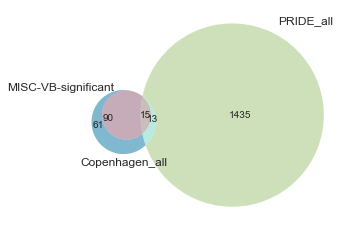

In [246]:
#significant_list = pd.DataFrame(processed_data[sign_prot_vb.identifier.tolist()].columns)[0].str.split('~', expand = True)[0].tolist()
copenhagen = pd.DataFrame(processed_data.drop(['sample','subject','group'], axis = 1).columns)[0].str.split('~', expand = True)[0].tolist()
pride = npx.drop(['SampleID','SubjectID','Timepoint','DiseaseCat'], axis = 1).columns.tolist()


st = [item for item in candidates if item in pride]
st_u = [item for item in st if item not in copenhagen]

stc = [item for item in st if item in copenhagen]

s_u = [item for item in candidates if item not in pride]
s_u = [item for item in s_u if item not in copenhagen]

tc = [item for item in pride if item in copenhagen]
tc_u = [item for item in tc if item not in candidates]
t_u = [item for item in pride if item not in candidates]
t_u = [item for item in t_u if item not in copenhagen]

c_u = [item for item in copenhagen if item not in pride]
c_u = [item for item in c_u if item not in candidates]

sc = [item for item in candidates if item in copenhagen]
sc_u = [item for item in sc if item not in pride]

stc_l = len(stc)

# Import the library
import matplotlib.pyplot as plt
from matplotlib_venn import venn3
#plt.figure(figsize=(10,10))

#fig, axes = plt.subplots(1, 1, figsize=(24, 8))
# Make the diagram
venn3(subsets = (len(s_u),len(t_u),len(st_u),len(c_u),len(sc_u),len(tc_u),len(stc)),
      set_labels = ('MISC-VB-significant', 'PRIDE_all','Copenhagen_all'), alpha = 0.5)
plt.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/venn_pride.pdf',bbox_inches='tight')
plt.show()

In [102]:
topfeatures_identifiers = optimal_features[5]
topfeatures_name = lfq_plot.protein.unique().tolist()

In [247]:
overlap_reduced = [item for item in topfeatures_name if item in overlap]
print('Of {} overlapping proteins between the two studies, only {} of our top {} proteins are int the overlap'.format(len(overlap),len(overlap_reduced), len(topfeatures_name)))
overlap_reduced

Of 28 overlapping proteins between the two studies, only 0 of our top 4 proteins are int the overlap


[]

In [104]:
pd.DataFrame(overlap, columns = ['ProteinName']).to_csv('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/28_overlap_table.tsv', sep ='\t', index = None)

### Make new model on the proteins in common (overlap) and check how it performs on our study and on the validation study

In [580]:
prepared_data_npx = zscore(processed_data[overlap_uniprot], axis = 1)
prepared_data_npx['group']=processed_data['group']

prepared_data_npx['y']=0
prepared_data_npx.loc[prepared_data_npx.group.isin(['MIS-C Acute Stage', 'MIS-C During Admission']),'y'] = 1

X_train = prepared_data_npx.loc[prepared_data_npx.group.isin(['MIS-C Acute Stage', 'Virus','Bacteria'])][overlap_uniprot].values
X_val = prepared_data_npx.loc[~prepared_data_npx.group.isin(['MIS-C Acute Stage', 'Virus','Bacteria'])][overlap_uniprot].values 
val_samples = processed_data.loc[~processed_data.group.isin(['MIS-C Acute Stage', 'Virus','Bacteria'])]['sample'].tolist()
y_train = prepared_data_npx.loc[prepared_data_npx.group.isin(['MIS-C Acute Stage', 'Virus','Bacteria'])].y.values
y_val = prepared_data_npx.loc[~prepared_data_npx.group.isin(['MIS-C Acute Stage', 'Virus','Bacteria'])].y.values
print(len(y_train), sum(y_train))
print(len(y_val), sum(y_val))

77 27
30 7


In [581]:
npx_sub = npx.loc[npx.DiseaseCat.isin(['MIS-C','Healthy'])]
npx_sub['y']=npx_sub.DiseaseCat.replace({'MIS-C':1,'Healthy':0})

X_npx = zscore(npx_sub[overlap], axis = 1).values
y_npx = npx_sub.y.values

print(len(y_npx), sum(y_npx))

59 34


In [584]:
# compute cv results
print('computing predictions for: {}'.format(optimal_models[5]))
classifier = optimal_models[5]
name = 'SVC_npx'
mccs = []
aucs = []
fits = []
mcc_val = []
auc_val = []
dfs = []
                        
# calculate performance during training
cv = StratifiedKFold(n_splits=no_cv)
for i, (train, test) in enumerate(cv.split(X_train, y_train)):
    print('cv: {}'.format(i+1))
    classifier.fit(X_train[train], y_train[train])
    calibrated = CalibratedClassifierCV(classifier, method='sigmoid', cv=5)
    calibrated.fit(X_train[train], y_train[train])
    classifier = calibrated
    fits.append(classifier)
    # predict for "test" set
    y_pred = classifier.predict(X_train[test])
    y_prob = classifier.predict_proba(X_train[test])[:,1]
    result = pd.DataFrame([y_train[test], y_pred, y_prob]).T
    result.columns = ['observed','predicted','probability']
    result['cv']=i+1
    result['model']=name
    result['run']='test'
    dfs.append(result)
    mccs.append(round(matthews_corrcoef(result.observed, result.predicted),2))
    aucs.append(round(roc_auc_score(result.observed,result.probability),2))
    # predict for validation sets
    y_pred = classifier.predict(X_val)
    y_prob = classifier.predict_proba(X_val)[:,1]
    result = pd.DataFrame([y_val, y_pred, y_prob]).T
    result.columns = ['observed','predicted','probability']
    result['cv']=i+1
    result['model']=name
    result['run']='val'
    dfs.append(result)  
    mcc_val.append(round(matthews_corrcoef(result.observed, result.predicted),2))
    auc_val.append(round(roc_auc_score(result.observed,result.probability),2))      
    # predict for npx sets
    y_pred = classifier.predict(X_npx)
    y_prob = classifier.predict_proba(X_npx)[:,1]
    result = pd.DataFrame([y_npx, y_pred, y_prob]).T
    result.columns = ['observed','predicted','probability']
    result['cv']=i+1
    result['model']=name
    result['run']='npx'
    dfs.append(result)  
    mcc_val.append(round(matthews_corrcoef(result.observed, result.predicted),2))
    auc_val.append(round(roc_auc_score(result.observed,result.probability),2))      
    
mcc_mean = np.mean(mccs)
mcc_std = np.std(mccs)
auroc_mean = np.mean(aucs)
auroc_std = np.std(aucs)
to_plot.append([name, mcc_mean, mcc_std, auroc_mean, auroc_std])
print('MCC: {}, AUROC: {}'.format(mcc_mean, auroc_mean))

result_npx = pd.concat(dfs)


computing predictions for: SVC(class_weight='balanced', kernel='linear', probability=True, random_state=7)
cv: 1
cv: 2
cv: 3
cv: 4
cv: 5
MCC: 0.818, AUROC: 0.974


NPXmean
MCC: 0.54
AUROC: 0.85


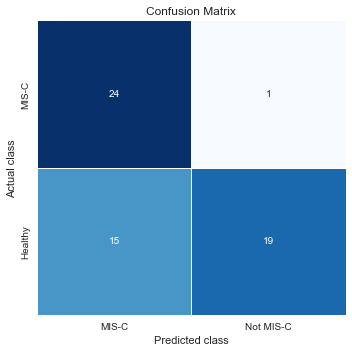

In [583]:
# CM
result_npx_mean = result_npx.loc[result_npx.run!='test']
result_npx_mean['id']=5*list(range(1,len(y_val)+len(y_npx)+1))
result_npx_mean = result_npx_mean.groupby('id').mean()
result_npx_mean.predicted = 0
result_npx_mean.loc[result_npx_mean.probability>=0.5,'predicted']=1
result_npx_mean.reset_index(inplace = True)
result_npx_mean['run']='npx'
result_npx_mean.loc[result_npx_mean.id.isin(list(range(1,len(y_val)+1))),'run']='validation'
result_npx_mean['group']=result_npx_mean.observed.replace({1:'MIS-C',0:'Not-MIS-C'})

sub = result_npx_mean.loc[result_npx_mean.run == 'npx']

print('NPXmean\nMCC: {}'.format(round(matthews_corrcoef(sub.observed, sub.predicted),2)))
print('AUROC: {}'.format(round(roc_auc_score(sub.observed, sub.probability),2)))

confusion_m = confusion_matrix(sub.observed, sub.predicted)

fig, ax = plt.subplots(figsize=(5,5))
s = sns.heatmap(confusion_m, annot = True, cbar = False, fmt = "d", linewidths = .5, cmap = "Blues",
           xticklabels=['MIS-C','Not MIS-C'], yticklabels=['MIS-C','Healthy'])
s.set(xlabel="Predicted class", ylabel='Actual class')
s.set(title = "Confusion Matrix")
fig.tight_layout()
#fig.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/test_confusion_pride.pdf')

NPX cv
MCC: 0.52
AUROC: 0.8505


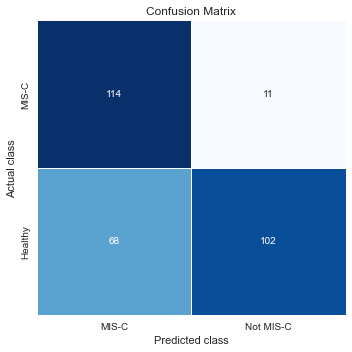

In [587]:
sub = result_npx.loc[result_npx.run == 'npx']

print('NPX cv\nMCC: {}'.format(round(matthews_corrcoef(sub.observed, sub.predicted),2)))
print('AUROC: {}'.format(round(roc_auc_score(sub.observed, sub.probability),4)))
confusion_m = confusion_matrix(sub.observed, sub.predicted)

fig, ax = plt.subplots(figsize=(5,5))
s = sns.heatmap(confusion_m, annot = True, cbar = False, fmt = "d", linewidths = .5, cmap = "Blues",
           xticklabels=['MIS-C','Not MIS-C'], yticklabels=['MIS-C','Healthy'])
s.set(xlabel="Predicted class", ylabel='Actual class')
s.set(title = "Confusion Matrix")
fig.tight_layout()

TEST cv
MCC: 0.81
AUROC: 0.95


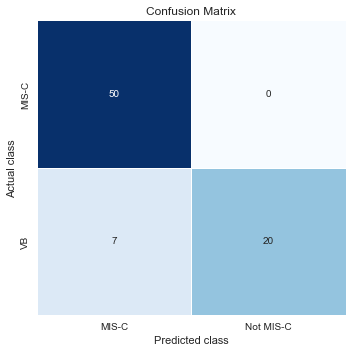

In [546]:
# CM
sub = result_npx.loc[result_npx.run == 'test']

print('TEST cv\nMCC: {}'.format(round(matthews_corrcoef(sub.observed, sub.predicted),2)))
print('AUROC: {}'.format(round(roc_auc_score(sub.observed, sub.probability),2)))

confusion_m = confusion_matrix(sub.observed, sub.predicted)

fig, ax = plt.subplots(figsize=(5,5))
s = sns.heatmap(confusion_m, annot = True, cbar = False, fmt = "d", linewidths = .5, cmap = "Blues",
           xticklabels=['MIS-C','Not MIS-C'], yticklabels=['MIS-C','VB'])
s.set(xlabel="Predicted class", ylabel='Actual class')
s.set(title = "Confusion Matrix")
fig.tight_layout()
#fig.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/test_confusion_pride.pdf')

Internal validation
MCC: 0.42
AUROC: 0.74


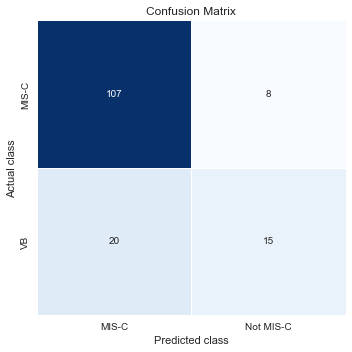

In [549]:
# CM
sub = result_npx.loc[result_npx.run == 'val']

print('Internal validation\nMCC: {}'.format(round(matthews_corrcoef(sub.observed, sub.predicted),2)))
print('AUROC: {}'.format(round(roc_auc_score(sub.observed, sub.probability),2)))
confusion_m = confusion_matrix(sub.observed, sub.predicted)

fig, ax = plt.subplots(figsize=(5,5))
s = sns.heatmap(confusion_m, annot = True, cbar = False, fmt = "d", linewidths = .5, cmap = "Blues",
           xticklabels=['MIS-C','Not MIS-C'], yticklabels=['MIS-C','VB'])
s.set(xlabel="Predicted class", ylabel='Actual class')
s.set(title = "Confusion Matrix")
fig.tight_layout()
#fig.savefig('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/test_confusion_pride.pdf')

In [551]:
fig = px.box(result_npx_mean.loc[result_npx_mean.run == 'npx'], x = 'probability', y = 'group', color = 'group', template = 'simple_white', points = 'all',
                   height = (800/7)*3, width = 800,
      #category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']}, 
      color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"])
fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_proba_npx.pdf',height = (800/7)*3, width = 800)
fig.show()

In [552]:
npx_plot = result_npx_mean.rename(columns = {'id':'sample'}).loc[result_npx_mean.run == 'npx'][result_mean.columns.tolist()]
npx_plot.probability = npx_plot.probability*100
gathered_results = pd.concat([result_mean, npx_plot])

In [553]:
fig = px.box(gathered_results, x = 'probability', y = 'group', color = 'group', template = 'simple_white', points = 'all',
      category_orders={"group": ["MIS-C Acute Stage",'MIS-C During Admission','MIS-C Full Recovery', 'Virus','Bacteria','Sepsis','Kawasaki']}, 
      color_discrete_sequence=["rgb(57,105,172)", "rgb(47,138,196)","rgb(179,179,179)","rgb(217,175,107)", "rgb(175,100,88)","rgb(204,97,176)","rgb(118,78,159)"])
fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_proba_mean_inclNPX.pdf')
fig.show()

In [554]:
for g in gathered_results.group.unique().tolist():
    sub = gathered_results.loc[(gathered_results.group == g)]
    print(g)
    print('mean prob. = {}'.format(np.round(np.mean(sub.probability),2)))
    print('median prob. = {}'.format(np.round(np.median(sub.probability),2)))
    print('IQR = {}\n'.format(np.round(np.quantile(sub.probability, 0.75)-np.quantile(sub.probability, 0.25),2)))
    #print('2std. prob. = {}\n'.format(np.round(2*np.std(sub.probability),2)))

Sepsis
mean prob. = 32.94
median prob. = 20.66
IQR = 31.13

Bacteria
mean prob. = 15.19
median prob. = 12.91
IQR = 7.07

Virus
mean prob. = 11.06
median prob. = 9.13
IQR = 5.96

Kawasaki
mean prob. = 52.3
median prob. = 55.75
IQR = 43.68

MIS-C Acute Stage
mean prob. = 79.07
median prob. = 82.97
IQR = 11.8

MIS-C During Admission
mean prob. = 83.71
median prob. = 87.67
IQR = 9.26

MIS-C Full Recovery
mean prob. = 7.79
median prob. = 7.28
IQR = 1.54

MIS-C
mean prob. = 56.41
median prob. = 55.12
IQR = 34.73

Not-MIS-C
mean prob. = 22.4
median prob. = 13.56
IQR = 29.22



In [537]:
result_npx_cv = result_npx.loc[result_npx.run == 'npx']
result_npx.run.value_counts()

val     150
test     77
Name: run, dtype: int64

In [557]:
result_npx_cv

,observed,predicted,probability,cv,model,run,id
0,1.0,1.0,0.963229,1,SVC_npx,npx,1
1,1.0,1.0,0.676574,1,SVC_npx,npx,2
2,1.0,0.0,0.080859,1,SVC_npx,npx,3
3,1.0,0.0,0.269329,1,SVC_npx,npx,4
4,1.0,1.0,0.577176,1,SVC_npx,npx,5
...,...,...,...,...,...,...,...
54,0.0,0.0,0.130216,5,SVC_npx,npx,55
55,0.0,1.0,0.510729,5,SVC_npx,npx,56
56,0.0,0.0,0.368230,5,SVC_npx,npx,57
57,0.0,0.0,0.154827,5,SVC_npx,npx,58


In [559]:
result_npx_roc = result_npx_mean.loc[result_npx_mean.run=='npx']
result_npx_roc['run']='npx_mean'
result_npx_cv = result_npx.loc[result_npx.run == 'npx']
result_npx_cv['id']=5*list(range(1,len(y_npx)+1))
result_npx_cv['group']=result_npx_cv.observed.replace({1:'MIS-C',0:'Not-MIS-C'})
result_npx_roc = pd.concat([result_npx_roc, result_npx_cv[result_npx_roc.columns.tolist()]])
#result_npx_roc['group']=result_npx_roc.observed.replace({1:'MIS-C',0:'Not-MIS-C'})
result_npx_roc.run.value_counts()

npx         295
npx_mean     59
Name: run, dtype: int64

In [566]:
fig = go.Figure()
# ROC for NPX cv
svc_test = result_npx_roc.loc[(result_npx_roc.run == 'npx')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_test.loc[svc_test.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'NPX (cv) auc = {} (std. = {}), mcc = {} (std. = {}))'.format(np.round(auc_mean*100,2), np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='grey', width=2, dash='dash')))
# ROC for mean
svc_val = result_npx_roc.loc[(result_npx_roc.run == 'npx_mean')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
fpr, tpr, thresholds = roc_curve(svc_val.observed, svc_val.probability, drop_intermediate=False)
interp_tpr = np.interp(fpr_mean, fpr, tpr)
interp_tpr[0] = 0.0
interp_tprs.append(interp_tpr)
auc_mean = roc_auc_score(svc_val.observed, svc_val.probability)
mcc_mean = matthews_corrcoef(svc_val.observed, svc_val.predicted)
print(roc_auc_score(svc_val.observed, svc_val.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0

fig.add_trace(go.Scatter(x = fpr_mean, name = 'NPX (mean) auc = {} , mcc = {}'.format(np.round(auc_mean*100,2),np.round(mcc_mean,2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='blue', width=2)))



fig.update_layout(template='simple_white',
    autosize=False,
    width=900,
    height=500,
    title="AUC NPX models",
    xaxis_title="FPR",
    yaxis_title="TPR",
    legend_title="",
    #legend=dict(y=1.1, orientation='h'),
    legend_traceorder="reversed",
    xaxis_range=[0,1],
    yaxis_range = [0,1])

fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_AUC_NPX.pdf', width = 850)
fig.show()

0.9047058823529411
0.9341176470588235
0.8294117647058824
0.7941176470588236
0.8705882352941177
0.8905882352941176


In [572]:
# combined with results from original model
fig = go.Figure()
# ROC for NPX cv
svc_test = result_npx_roc.loc[(result_npx_roc.run == 'npx')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_test.loc[svc_test.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'NPX (cv) auc = {} (std. = {}), mcc = {} (std. = {}))'.format(np.round(auc_mean*100,2), np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='grey', width=2)))
# ROC for mean
svc_val = result_npx_roc.loc[(result_npx_roc.run == 'npx_mean')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
fpr, tpr, thresholds = roc_curve(svc_val.observed, svc_val.probability, drop_intermediate=False)
interp_tpr = np.interp(fpr_mean, fpr, tpr)
interp_tpr[0] = 0.0
interp_tprs.append(interp_tpr)
auc_mean = roc_auc_score(svc_val.observed, svc_val.probability)
mcc_mean = matthews_corrcoef(svc_val.observed, svc_val.predicted)
print(roc_auc_score(svc_val.observed, svc_val.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0

fig.add_trace(go.Scatter(x = fpr_mean, name = 'NPX (mean) auc = {} , mcc = {}'.format(np.round(auc_mean*100,2),np.round(mcc_mean,2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='blue', width=2, dash='dash')))

# ROC for TEST
svc_test = result_df.loc[(result_df.model == 'SVC')&(result_df.run == 'test')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_test.loc[svc_test.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'TEST auc = {} (std. = {}), mcc = {} (std. = {}))'.format(auc_mean*100, np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='grey', width=2, dash='dash')))
# ROC for val
svc_val = result_df.loc[(result_df.model == 'SVC')&(result_df.run == 'val')]
fpr_mean = np.linspace(0, 1, 100)
interp_tprs = []
aucs = []
mccs = []
for cv in list(range(1,5+1)):
    svc_sub = svc_val.loc[svc_val.cv == cv]
    fpr, tpr, thresholds = roc_curve(svc_sub.observed, svc_sub.probability, drop_intermediate=False)
    interp_tpr = np.interp(fpr_mean, fpr, tpr)
    interp_tpr[0] = 0.0
    interp_tprs.append(interp_tpr)
    aucs.append(roc_auc_score(svc_sub.observed, svc_sub.probability))
    mccs.append(matthews_corrcoef(svc_sub.observed, svc_sub.predicted))
    print(roc_auc_score(svc_sub.observed, svc_sub.probability))
tpr_mean     = np.mean(interp_tprs, axis=0)
tpr_mean[-1] = 1.0
tpr_std      = np.std(interp_tprs, axis=0)
tpr_upper    = tpr_mean+tpr_std
tpr_lower    = tpr_mean-tpr_std
auc_mean=sum(aucs)/5

fig.add_trace(go.Scatter(
    x=np.concatenate([fpr_mean,fpr_mean[::-1]]),
    y=np.concatenate([tpr_upper, tpr_lower[::-1]]),
    fill='toself', opacity=0.5, name = 'std.'))
fig.add_trace(go.Scatter(x = fpr_mean, name = 'val auc = {} (std. = {}), mcc = {} (std. = {})'.format(np.round(auc_mean*100,2), np.round(2*np.std(aucs*100),2),np.round(np.mean(mccs),2), np.round(2*np.std(mccs),2)), 
                         y=tpr_mean, 
                         mode='lines', 
                         line=dict(color='green', width=2)))




fig.update_layout(template='simple_white',
    autosize=False,
    width=900,
    height=500,
    title="RFECV for SVC classifier",
    xaxis_title="FPR",
    yaxis_title="TPR",
    legend_title="",
    #legend=dict(y=1.1, orientation='h'),
    legend_traceorder="reversed",
    xaxis_range=[0,1],
    yaxis_range = [0,1])

fig.write_image('/Users/tzx804/projects/collaborations/nicolai/misc/sepsis/output/SVC4_AUC_OriginalandNPX.pdf', width = 850)
fig.show()

0.9047058823529411
0.9341176470588235
0.8294117647058824
0.7941176470588236
0.8705882352941177
0.8905882352941176
1.0
1.0
1.0
1.0
1.0
0.9192546583850932
0.9440993788819877
0.9316770186335405
0.9316770186335405
0.9440993788819877
